# **The Age of Recommender Systems**

## 0.1 Table of Contents<a class="anchor" id="0.1"></a>

1. [About the Dataset](#1)
2. [Importing Dataset](#2)
3. [Data Exploration](#3)
4. [Data Pre-processing](#4)
5. [Item-Based Collaborative Filterings](#5)
6. [ Content-Based Collaborative Filterings](#6)
7. [Summary based Recommender](#7)
8. [Comparison of All Recommenders](#8)
9. [Conclusion](#9)

The rapid growth of data collection has led to a new era of information. Data is being used to create more efficient systems and this is where Recommendation Systems come into play.  Recommendation Systems are a type of **information filtering systems** as they improve the quality of search results and provides items that are more relevant to the search item or are realted to the search history of the user.  

They are used to predict the **rating** or **preference** that a user would give to an item. Almost every major tech company has applied them in some form or the other: Amazon uses it to suggest products to customers, YouTube uses it to decide which video to play next on autoplay, and Facebook uses it to recommend pages to like and people to follow. 
Moreover,  companies like Amazon, Netflix and Spotify  depend highly on the effectiveness of their recommendation engines for their business and sucees.

(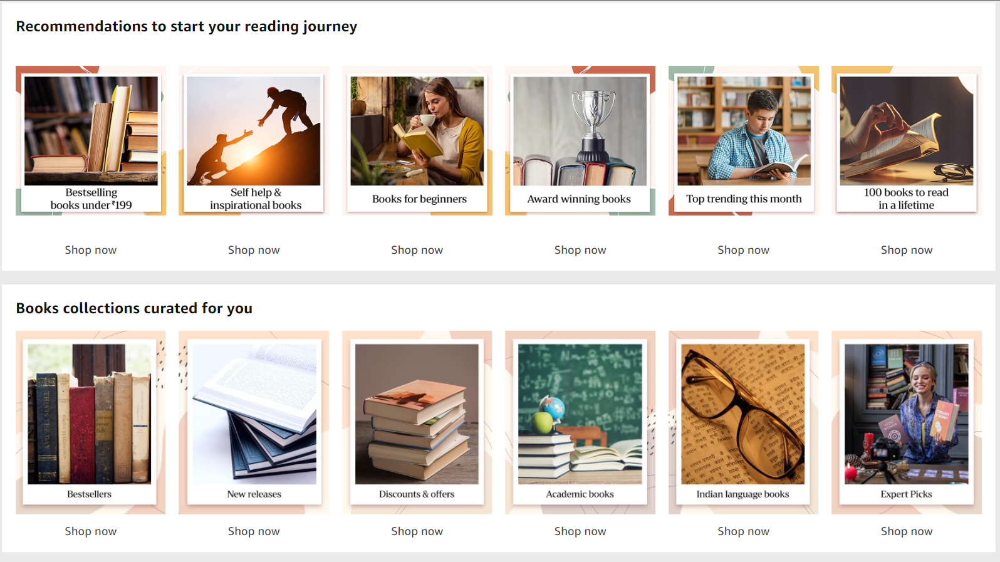https://screenrec.com/share/T0WdvCYHa7)

There are basically three types of recommender systems:-

> *  **Demographic Filtering**- They offer generalized recommendations to every user, based on movie popularity and/or genre. The System recommends the same movies to users with similar demographic features. Since each user is different , this approach is considered to be too simple. The basic idea behind this system is that movies that are more popular and critically acclaimed will have a higher probability of being liked by the average audience.

> *  **Content Based Filtering**- They suggest similar items based on a particular item. This system uses item metadata, such as genre, director, description, actors, etc. for movies, to make these recommendations. The general idea behind these recommender systems is that if a person liked a particular item, he or she will also like an item that is similar to it.

> *  **Collaborative Filtering**- This system matches persons with similar interests and provides recommendations based on this matching. Collaborative filters do not require item metadata like its content-based counterparts.

### About Dataset<a class="anchor" id="1"></a>
Contains 278,858 users (anonymized but with demographic information) providing 1,149,780 ratings (explicit / implicit) about 271,379 books.

In [1]:
import os
import re
import nltk
import requests
import warnings
import pandas as pd
import numpy as np
from math import ceil
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

from nltk.corpus import stopwords
nltk.download('punkt')

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.decomposition import TruncatedSVD

from PIL import Image
warnings.filterwarnings('ignore')
from dataprep.eda import plot, plot_correlation, plot_missing, create_report

[nltk_data] Downloading package punkt to C:\Users\Moin
[nltk_data]     Dalvi\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


# Attribute Information:

● user_id : Every user identified with a unique id 

● location : Location of the book launch (Book launch location)

● age : Age of the Book (From the Year it was Published)

● isbn : Every book identified with a unique id 

● rating : Rating of the corresponding book by the corresponding user 

● book_title : Book Title given by Book Author

● year_of_publication : The year the book was published

● publisher : The publisher of the Book

● img_s : The Book Poster URL in small size

● img_m : The Book Poster URL in medium size

● img_l : The Book Poster URL in large size

● Summary : The Book Summary

● Language : The Language the book is written

● Category : Genre of the Book

● Country, State and City : Where Exactly the book originates from

### Importing Dataset<a class="anchor" id="2"></a>

In [2]:
books = pd.read_csv('C:/Users/Moin Dalvi/Documents/Data Science Material/Data Science/Python/Datasets/Preprocessed_data.csv')
books

,Unnamed: 0,user_id,location,age,isbn,rating,book_title,book_author,year_of_publication,publisher,img_s,img_m,img_l,Summary,Language,Category,city,state,country
0,0,2,"stockton, california, usa",18.0000,0195153448,0,Classical Mythology,Mark P. O. Morford,2002.0,Oxford University Press,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...,Provides an introduction to classical myths pl...,en,['Social Science'],stockton,california,usa
1,1,8,"timmins, ontario, canada",34.7439,0002005018,5,Clara Callan,Richard Bruce Wright,2001.0,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,"In a small town in Canada, Clara Callan reluct...",en,['Actresses'],timmins,ontario,canada
2,2,11400,"ottawa, ontario, canada",49.0000,0002005018,0,Clara Callan,Richard Bruce Wright,2001.0,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,"In a small town in Canada, Clara Callan reluct...",en,['Actresses'],ottawa,ontario,canada
3,3,11676,"n/a, n/a, n/a",34.7439,0002005018,8,Clara Callan,Richard Bruce Wright,2001.0,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,"In a small town in Canada, Clara Callan reluct...",en,['Actresses'],NaN,NaN,NaN
4,4,41385,"sudbury, ontario, canada",34.7439,0002005018,0,Clara Callan,Richard Bruce Wright,2001.0,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,"In a small town in Canada, Clara Callan reluct...",en,['Actresses'],sudbury,ontario,canada
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1031170,1031170,278851,"dallas, texas, usa",33.0000,0743203763,0,As Hogan Said . . . : The 389 Best Things Anyo...,Randy Voorhees,2000.0,Simon & Schuster,http://images.amazon.com/images/P/0743203763.0...,http://images.amazon.com/images/P/0743203763.0...,http://images.amazon.com/images/P/0743203763.0...,Golf lovers will revel in this collection of t...,en,['Humor'],dallas,texas,usa
1031171,1031171,278851,"dallas, texas, usa",33.0000,0767907566,5,All Elevations Unknown: An Adventure in the He...,Sam Lightner,2001.0,Broadway Books,http://images.amazon.com/images/P/0767907566.0...,http://images.amazon.com/images/P/0767907566.0...,http://images.amazon.com/images/P/0767907566.0...,A daring twist on the travel-adventure genre t...,en,['Nature'],dallas,texas,usa
1031172,1031172,278851,"dallas, texas, usa",33.0000,0884159221,7,Why stop?: A guide to Texas historical roadsid...,Claude Dooley,1985.0,Lone Star Books,http://images.amazon.com/images/P/0884159221.0...,http://images.amazon.com/images/P/0884159221.0...,http://images.amazon.com/images/P/0884159221.0...,9,9,9,dallas,texas,usa
1031173,1031173,278851,"dallas, texas, usa",33.0000,0912333022,7,The Are You Being Served? Stories: 'Camping In...,Jeremy Lloyd,1997.0,Kqed Books,http://images.amazon.com/images/P/0912333022.0...,http://images.amazon.com/images/P/0912333022.0...,http://images.amazon.com/images/P/0912333022.0...,These hilarious stories by the creator of publ...,en,['Fiction'],dallas,texas,usa


In [36]:
books.img_l.unique()[0]

'http://images.amazon.com/images/P/0195153448.01.LZZZZZZZ.jpg'

In [99]:
books.head()

,Unnamed: 0,user_id,location,age,isbn,rating,book_title,book_author,year_of_publication,publisher,img_s,img_m,img_l,Summary,Language,Category,city,state,country
0,0,2,"stockton, california, usa",18.0000,0195153448,0,Classical Mythology,Mark P. O. Morford,2002.0,Oxford University Press,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...,Provides an introduction to classical myths pl...,en,['Social Science'],stockton,california,usa
1,1,8,"timmins, ontario, canada",34.7439,0002005018,5,Clara Callan,Richard Bruce Wright,2001.0,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,"In a small town in Canada, Clara Callan reluct...",en,['Actresses'],timmins,ontario,canada
2,2,11400,"ottawa, ontario, canada",49.0000,0002005018,0,Clara Callan,Richard Bruce Wright,2001.0,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,"In a small town in Canada, Clara Callan reluct...",en,['Actresses'],ottawa,ontario,canada
3,3,11676,"n/a, n/a, n/a",34.7439,0002005018,8,Clara Callan,Richard Bruce Wright,2001.0,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,"In a small town in Canada, Clara Callan reluct...",en,['Actresses'],NaN,NaN,NaN
4,4,41385,"sudbury, ontario, canada",34.7439,0002005018,0,Clara Callan,Richard Bruce Wright,2001.0,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,"In a small town in Canada, Clara Callan reluct...",en,['Actresses'],sudbury,ontario,canada


In [101]:
books.Summary[1]

'In a small town in Canada, Clara Callan reluctantly takes leave of her\nsister, Nora, who is bound for New York.'

### Data-Explorations<a class="anchor" id="3"></a>

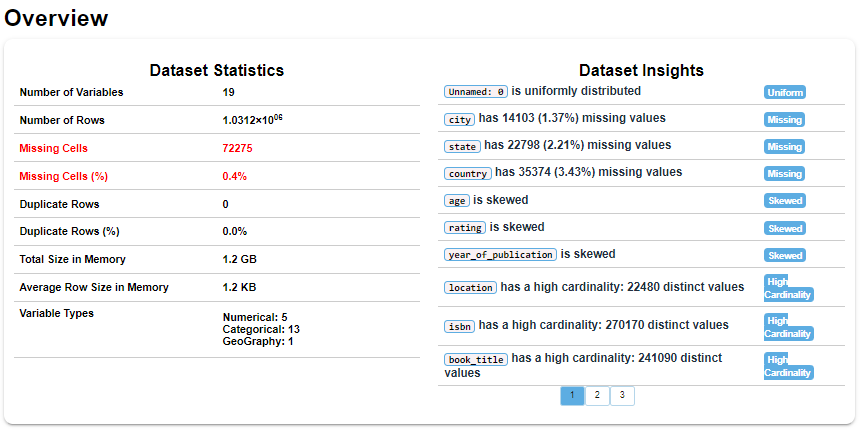
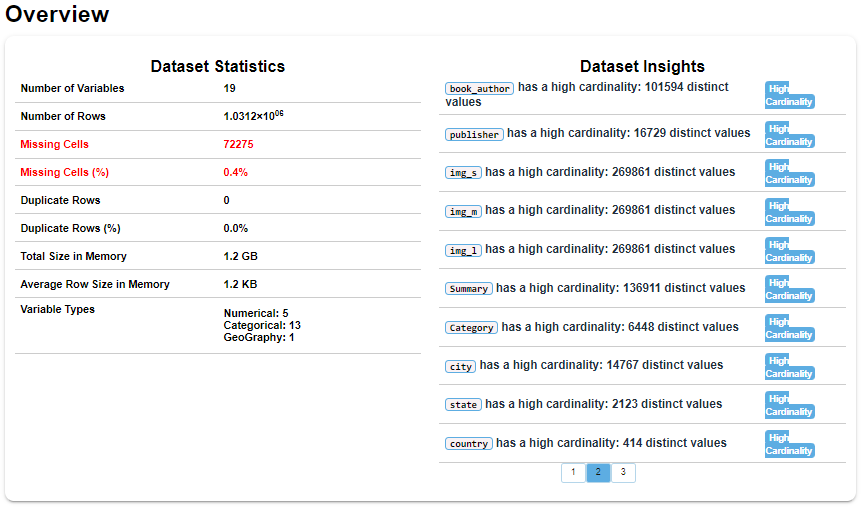
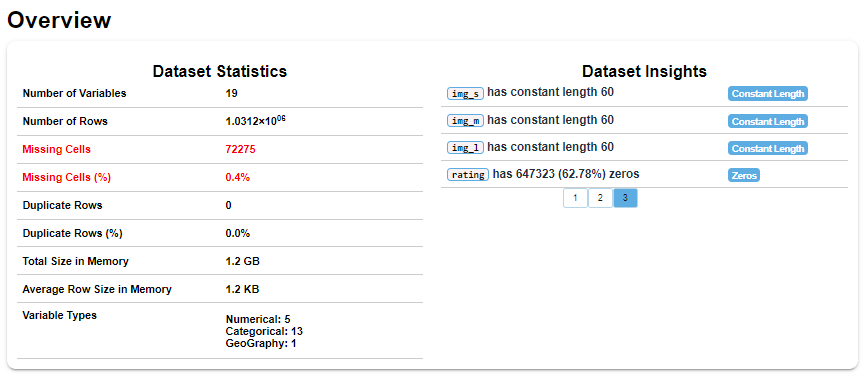
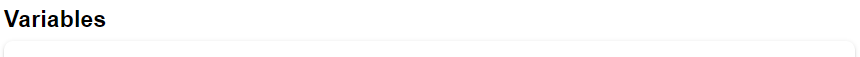
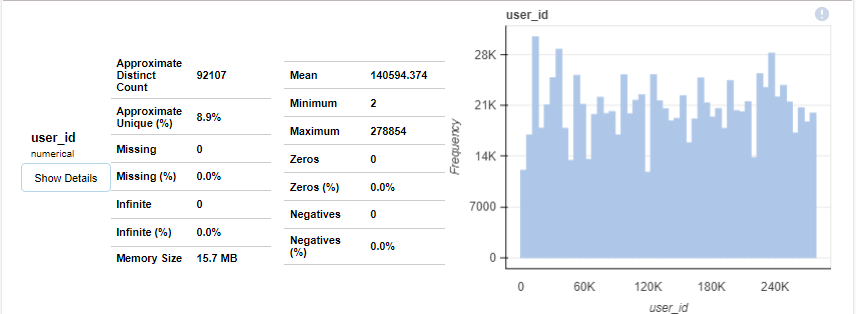
...
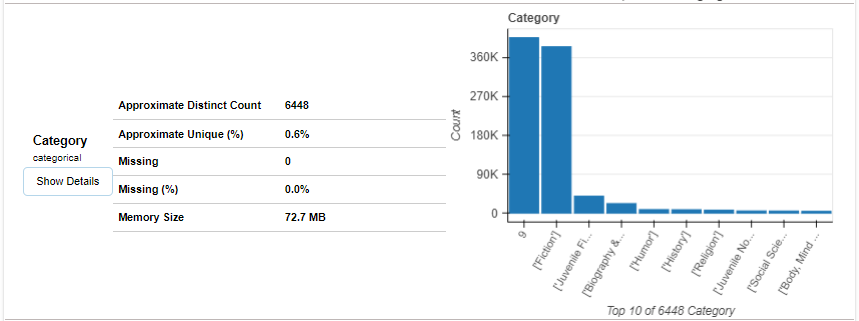
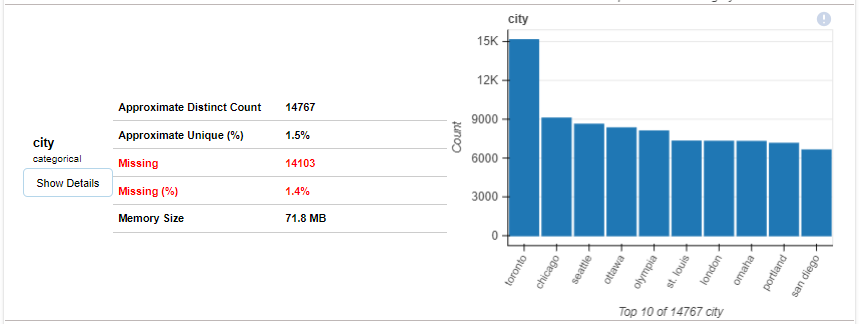
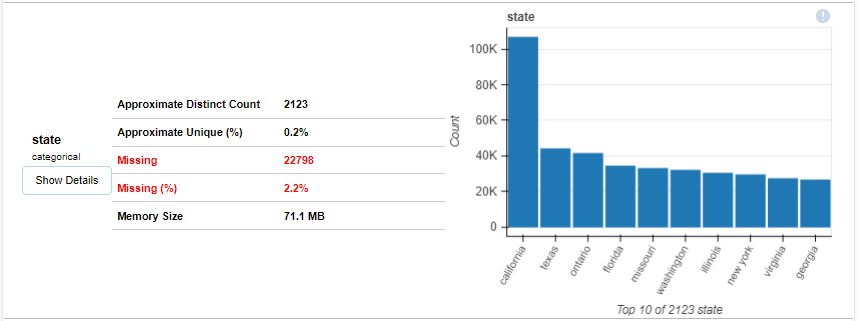
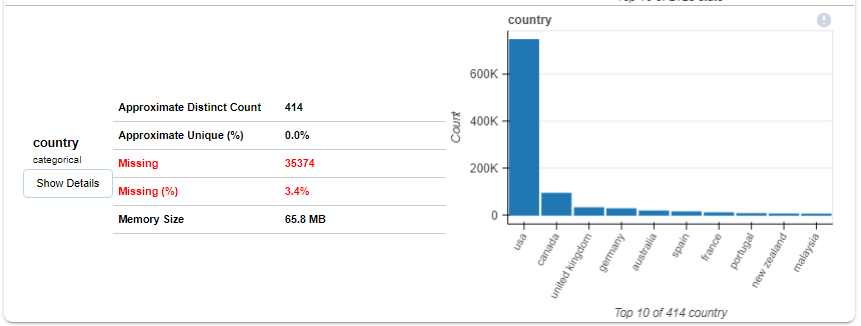

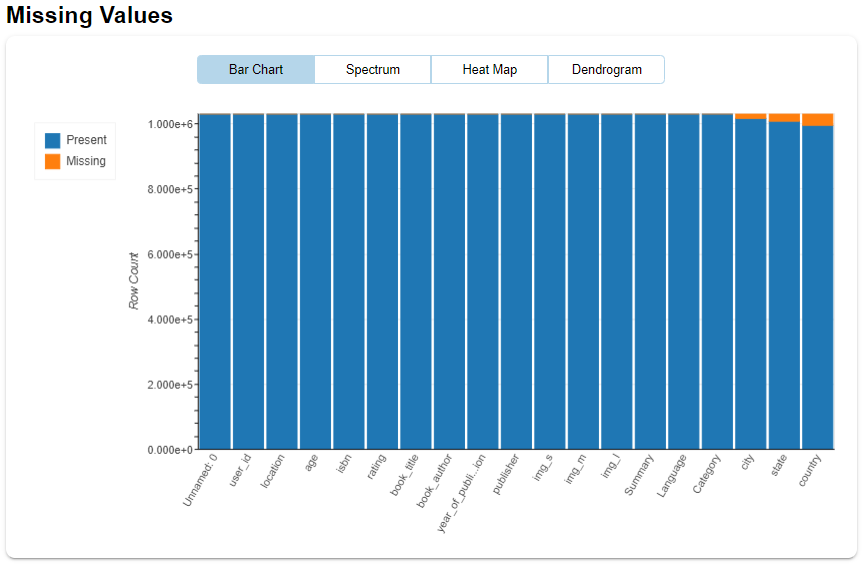

In [ ]:
create_report(books)

In [106]:
books.isnull().sum()

Unnamed: 0                 0
user_id                    0
location                   0
age                        0
isbn                       0
rating                     0
book_title                 0
book_author                0
year_of_publication        0
publisher                  0
img_s                      0
img_m                      0
img_l                      0
Summary                    0
Language                   0
Category                   0
city                   14103
state                  22798
country                35374
dtype: int64

In [57]:
len(books.isbn.unique())

270170

In [58]:
#Unique reader count
books["user_id"].nunique()

92107

In [59]:
books.book_title.nunique()

241090

In [34]:
books["rating"].describe()

count    1.031175e+06
mean     2.839022e+00
std      3.854149e+00
min      0.000000e+00
25%      0.000000e+00
50%      0.000000e+00
75%      7.000000e+00
max      1.000000e+01
Name: rating, dtype: float64

In [11]:
books.Category.value_counts()

9                                            406102
['Fiction']                                  385135
['Juvenile Fiction']                          39617
['Biography & Autobiography']                 22390
['Humor']                                      8500
                                              ...  
['Angel (Fictitious character : Whedon)']         1
['Face']                                          1
['Church renewal']                                1
['Supermarkets']                                  1
['Alternative histories']                         1
Name: Category, Length: 6448, dtype: int64

In [38]:
#Removing books with zero ratings from the data set
books[books["rating"]==0]

,Unnamed: 0,user_id,location,age,isbn,rating,book_title,book_author,year_of_publication,publisher,img_s,img_m,img_l,Summary,Language,Category,city,state,country
0,0,2,"stockton, california, usa",18.0000,0195153448,0,Classical Mythology,Mark P. O. Morford,2002.0,Oxford University Press,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...,http://images.amazon.com/images/P/0195153448.0...,Provides an introduction to classical myths pl...,en,['Social Science'],stockton,california,usa
2,2,11400,"ottawa, ontario, canada",49.0000,0002005018,0,Clara Callan,Richard Bruce Wright,2001.0,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,"In a small town in Canada, Clara Callan reluct...",en,['Actresses'],ottawa,ontario,canada
4,4,41385,"sudbury, ontario, canada",34.7439,0002005018,0,Clara Callan,Richard Bruce Wright,2001.0,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,"In a small town in Canada, Clara Callan reluct...",en,['Actresses'],sudbury,ontario,canada
6,6,85526,"victoria, british columbia, canada",36.0000,0002005018,0,Clara Callan,Richard Bruce Wright,2001.0,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,"In a small town in Canada, Clara Callan reluct...",en,['Actresses'],victoria,british columbia,canada
7,7,96054,"ottawa, ontario, canada",29.0000,0002005018,0,Clara Callan,Richard Bruce Wright,2001.0,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,http://images.amazon.com/images/P/0002005018.0...,"In a small town in Canada, Clara Callan reluct...",en,['Actresses'],ottawa,ontario,canada
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1031165,1031165,278843,"pismo beach, california, usa",28.0000,1874061149,0,The Queen's Gambit,Walter Tevis,1996.0,Texas Bookman,http://images.amazon.com/images/P/1874061149.0...,http://images.amazon.com/images/P/1874061149.0...,http://images.amazon.com/images/P/1874061149.0...,"Engaging and fast-paced, The Queen&#39;s Gambi...",en,['Fiction'],pismo beach,california,usa
1031166,1031166,278849,"georgetown, ontario, canada",23.0000,0920656307,0,Secret of Willow Castle,Ly Cook,1911.0,Firefly Books Ltd,http://images.amazon.com/images/P/0920656307.0...,http://images.amazon.com/images/P/0920656307.0...,http://images.amazon.com/images/P/0920656307.0...,Canadian story early 19th century Orphaned ser...,en,['Canada'],georgetown,ontario,canada
1031167,1031167,278851,"dallas, texas, usa",33.0000,0028630289,0,Frommer's 2000 California (Frommer's Californi...,Erika Lenkert,1999.0,Frommer's,http://images.amazon.com/images/P/0028630289.0...,http://images.amazon.com/images/P/0028630289.0...,http://images.amazon.com/images/P/0028630289.0...,9,9,9,dallas,texas,usa
1031168,1031168,278851,"dallas, texas, usa",33.0000,0312266448,0,The Military Quotation Book : Revised and Expa...,James Charlton,2002.0,Thomas Dunne Books,http://images.amazon.com/images/P/0312266448.0...,http://images.amazon.com/images/P/0312266448.0...,http://images.amazon.com/images/P/0312266448.0...,"Contains more than 1,200 quotations about war,...",en,['Reference'],dallas,texas,usa


In [13]:
books[books['Category']=='9'].head(10)

,Unnamed: 0,user_id,location,age,isbn,rating,book_title,book_author,year_of_publication,publisher,img_s,img_m,img_l,Summary,Language,Category,city,state,country
68,68,8,"timmins, ontario, canada",34.7439,0671870432,0,PLEADING GUILTY,Scott Turow,1993.0,Audioworks,http://images.amazon.com/images/P/0671870432.0...,http://images.amazon.com/images/P/0671870432.0...,http://images.amazon.com/images/P/0671870432.0...,9,9,9,timmins,ontario,canada
69,69,11676,"n/a, n/a, n/a",34.7439,0671870432,8,PLEADING GUILTY,Scott Turow,1993.0,Audioworks,http://images.amazon.com/images/P/0671870432.0...,http://images.amazon.com/images/P/0671870432.0...,http://images.amazon.com/images/P/0671870432.0...,9,9,9,NaN,NaN,NaN
70,70,24539,"cabrils, catalunya, spain",34.7439,0671870432,0,PLEADING GUILTY,Scott Turow,1993.0,Audioworks,http://images.amazon.com/images/P/0671870432.0...,http://images.amazon.com/images/P/0671870432.0...,http://images.amazon.com/images/P/0671870432.0...,9,9,9,cabrils,catalunya,spain
80,80,8,"timmins, ontario, canada",34.7439,0887841740,5,The Middle Stories,Sheila Heti,2004.0,House of Anansi Press,http://images.amazon.com/images/P/0887841740.0...,http://images.amazon.com/images/P/0887841740.0...,http://images.amazon.com/images/P/0887841740.0...,9,9,9,timmins,ontario,canada
81,81,92861,"vancouver, british columbia, canada",34.7439,0887841740,0,The Middle Stories,Sheila Heti,2004.0,House of Anansi Press,http://images.amazon.com/images/P/0887841740.0...,http://images.amazon.com/images/P/0887841740.0...,http://images.amazon.com/images/P/0887841740.0...,9,9,9,vancouver,british columbia,canada
82,82,8,"timmins, ontario, canada",34.7439,1552041778,5,Jane Doe,R. J. Kaiser,1999.0,Mira Books,http://images.amazon.com/images/P/1552041778.0...,http://images.amazon.com/images/P/1552041778.0...,http://images.amazon.com/images/P/1552041778.0...,9,9,9,timmins,ontario,canada
83,83,8,"timmins, ontario, canada",34.7439,1558746218,0,A Second Chicken Soup for the Woman's Soul (Ch...,Jack Canfield,1998.0,Health Communications,http://images.amazon.com/images/P/1558746218.0...,http://images.amazon.com/images/P/1558746218.0...,http://images.amazon.com/images/P/1558746218.0...,9,9,9,timmins,ontario,canada
84,84,3363,"knoxville, tennessee, usa",29.0000,1558746218,0,A Second Chicken Soup for the Woman's Soul (Ch...,Jack Canfield,1998.0,Health Communications,http://images.amazon.com/images/P/1558746218.0...,http://images.amazon.com/images/P/1558746218.0...,http://images.amazon.com/images/P/1558746218.0...,9,9,9,knoxville,tennessee,usa
85,85,61501,"timmins, ontario, canada",34.7439,1558746218,7,A Second Chicken Soup for the Woman's Soul (Ch...,Jack Canfield,1998.0,Health Communications,http://images.amazon.com/images/P/1558746218.0...,http://images.amazon.com/images/P/1558746218.0...,http://images.amazon.com/images/P/1558746218.0...,9,9,9,timmins,ontario,canada
86,86,148514,"barstow, california, usa",34.7439,1558746218,10,A Second Chicken Soup for the Woman's Soul (Ch...,Jack Canfield,1998.0,Health Communications,http://images.amazon.com/images/P/1558746218.0...,http://images.amazon.com/images/P/1558746218.0...,http://images.amazon.com/images/P/1558746218.0...,9,9,9,barstow,california,usa


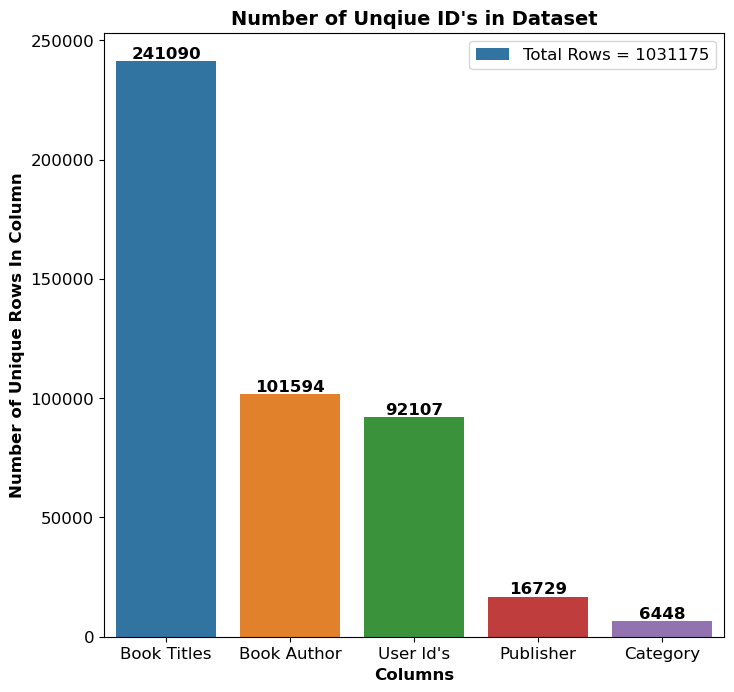

In [176]:
f, axe = plt.subplots(1,1, figsize=(8,8), dpi=100)
ax = sns.barplot(x=['Book Titles','Book Author',"User Id's",'Publisher','Category'], y=[len(books.book_title.unique()),len(books.book_author.unique()),len(books.user_id.unique()),len(books.publisher.unique()),len(books.Category.unique())], ax = axe
            ,label='Total Rows = {}'.format(len(books)))
axe.set_xlabel('Columns', size=12,fontweight = 'bold')
axe.set_ylabel('Number of Unique Rows In Column', size=12,fontweight = 'bold')
plt.yticks(fontsize=12)
plt.xticks(fontsize=12)
plt.legend(loc='best', fontsize  = 'large')
plt.title("Number of Unqiue ID's in Dataset", fontsize = 14, fontweight = 'bold')
for i in ax.containers:
    ax.bar_label(i,color = 'black', fontweight = 'bold', fontsize= 12)
plt.show()

In [177]:
ratings = pd.DataFrame(books.groupby('book_title')['rating'].mean())
ratings.rename({'rating':'Mean Ratings'}, axis=1 , inplace =True)
ratings['No of times Rated'] = pd.DataFrame(books.groupby('book_title')['rating'].count())
ratings

,Mean Ratings,No of times Rated
book_title,,
"A Light in the Storm: The Civil War Diary of Amelia Martin, Fenwick Island, Delaware, 1861 (Dear America)",2.250000,4
Always Have Popsicles,0.000000,1
Apple Magic (The Collector's series),0.000000,1
"Ask Lily (Young Women of Faith: Lily Series, Book 5)",8.000000,1
Beyond IBM: Leadership Marketing and Finance for the 1990s,0.000000,1
...,...,...
Ã?Â?lpiraten.,0.000000,2
Ã?Â?rger mit Produkt X. Roman.,5.250000,4
Ã?Â?sterlich leben.,7.000000,1


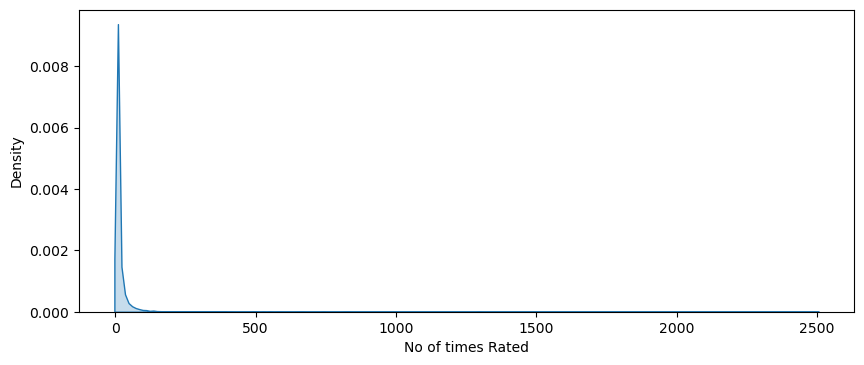

In [178]:
# Number of ratings per product KDE distribution
plt.figure(figsize=(10,4), dpi=100)
ax = sns.kdeplot(ratings['No of times Rated'], shade=True, color='#1f77b4')
plt.show()

<AxesSubplot:>

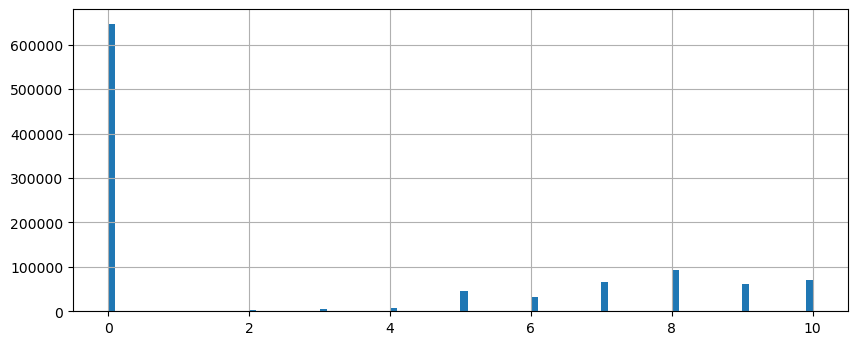

In [179]:
plt.figure(figsize=(10,4), dpi=100)
books['rating'].hist(bins=100)

<Figure size 1000x400 with 0 Axes>

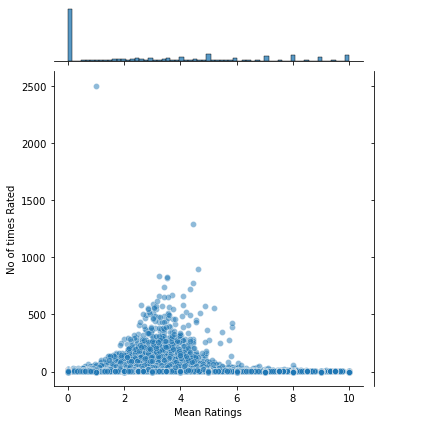

In [180]:
plt.figure(figsize=(10,4), dpi=100)
sns.jointplot(x='Mean Ratings',y='No of times Rated',data=ratings,alpha=0.5)
plt.show()

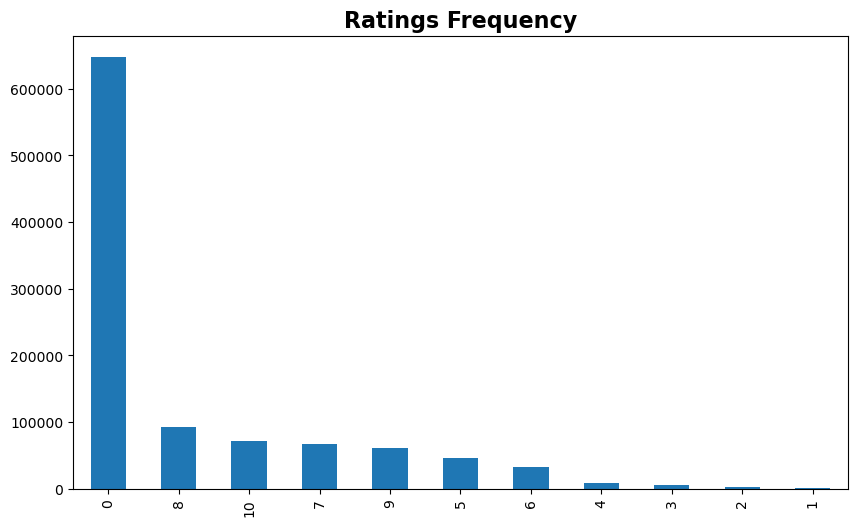

In [181]:
plt.figure(figsize=(10,6), dpi=100)
books['rating'].value_counts().plot(kind='bar')
plt.title('Ratings Frequency',  fontsize = 16, fontweight = 'bold')
plt.show()

In [183]:
popular_books = pd.DataFrame(books.groupby('book_title')['rating'].count())
most_popular = popular_books.sort_values('rating', ascending=False)
most_popular.rename({'rating':'No of times Rated'}, axis=1, inplace=True)
most_popular.head(10)

,No of times Rated
book_title,
Wild Animus,2502
The Lovely Bones: A Novel,1295
The Da Vinci Code,898
A Painted House,838
The Nanny Diaries: A Novel,828
Bridget Jones's Diary,815
The Secret Life of Bees,774
Divine Secrets of the Ya-Ya Sisterhood: A Novel,740
The Red Tent (Bestselling Backlist),723


<Figure size 2400x1600 with 0 Axes>

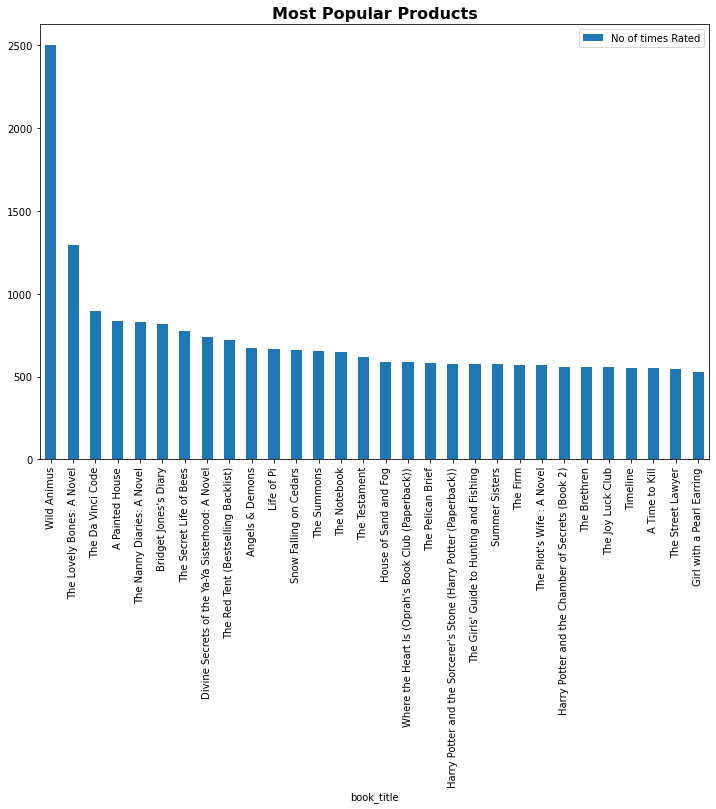

In [185]:
plt.figure(figsize=(12,8), dpi=200)
most_popular.head(30).plot(kind = "bar",figsize=(12,8))
plt.title('Most Popular Products',  fontsize = 16, fontweight = 'bold')
plt.show()

**Analysis:**

* The above graph gives us the most popular books (arranged in descending order) sold by the business.

* For eaxmple, **Wild Animus** has sales of over 2500, the next most popular books **The Lovely Bones: A Novel** has sales over 1000, etc.     

In [192]:
ratings.sort_values('No of times Rated',ascending=False)

,Mean Ratings,No of times Rated
book_title,,
Wild Animus,1.019584,2502
The Lovely Bones: A Novel,4.468726,1295
The Da Vinci Code,4.642539,898
A Painted House,3.231504,838
The Nanny Diaries: A Novel,3.530193,828
...,...,...
Real Men Talking,10.000000,1
Real Men Sell Bras (Five Star First Edition Romance Series),9.000000,1
Fabulous Fallacies: More Than 300 Popular Beliefs That Are Not True,0.000000,1


In [229]:
top_most_frequent_rated_products = ratings[ratings['No of times Rated']>=50].sort_values('No of times Rated',ascending=False)
top_most_frequent_rated_products

,Mean Ratings,No of times Rated
book_title,,
Wild Animus,1.019584,2502
The Lovely Bones: A Novel,4.468726,1295
The Da Vinci Code,4.642539,898
A Painted House,3.231504,838
The Nanny Diaries: A Novel,3.530193,828
...,...,...
Charms for Easy Life,3.140000,50
The Meaning Of Life,4.740000,50
Perfect,3.020000,50


In [230]:
top_most_frequent_rated_products = top_most_frequent_rated_products[top_most_frequent_rated_products['Mean Ratings']>=5]
top_most_frequent_rated_products

,Mean Ratings,No of times Rated
book_title,,
Harry Potter and the Chamber of Secrets (Book 2),5.183453,556
Harry Potter and the Prisoner of Azkaban (Book 3),5.852804,428
Harry Potter and the Goblet of Fire (Book 4),5.824289,387
Harry Potter and the Order of the Phoenix (Book 5),5.501441,347
The Hobbit : The Enchanting Prelude to The Lord of the Rings,5.007117,281
Harry Potter and the Sorcerer's Stone (Book 1),5.737410,278
Ender's Game (Ender Wiggins Saga (Paperback)),5.409639,249
The Little Prince,5.815603,141
The Perks of Being a Wallflower,5.144231,104


In [232]:
top_most_frequent_rated_products['Mean Ratings'].head(10).index

Index(['Harry Potter and the Chamber of Secrets (Book 2)',
       'Harry Potter and the Prisoner of Azkaban (Book 3)',
       'Harry Potter and the Goblet of Fire (Book 4)',
       'Harry Potter and the Order of the Phoenix (Book 5)',
       'The Hobbit : The Enchanting Prelude to The Lord of the Rings',
       'Harry Potter and the Sorcerer's Stone (Book 1)',
       'Ender's Game (Ender Wiggins Saga (Paperback))', 'The Little Prince',
       'The Perks of Being a Wallflower', 'Jitterbug Perfume'],
      dtype='object', name='book_title')

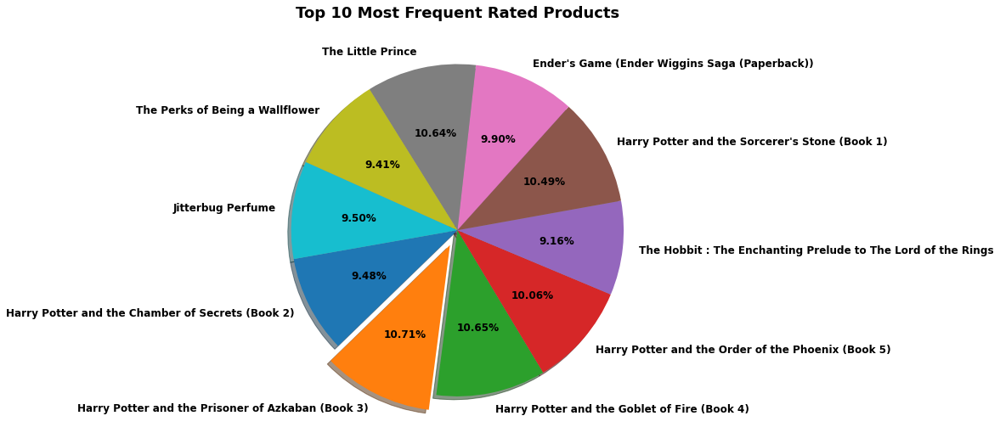

In [233]:
plt.figure(figsize = (16,9))
plt.pie(top_most_frequent_rated_products['Mean Ratings'].head(10),
       labels=top_most_frequent_rated_products['Mean Ratings'].head(10).index,
       explode = [0.0,0.1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0],
       autopct= '%.2f%%',
       shadow= True,
       startangle= 190,
       textprops = {'size':'large',
                   'fontweight':'bold',
                    'rotation':'0',
                   'color':'black'})
#plt.legend(loc= 'best')
plt.title("Top 10 Most Frequent Rated Products", fontsize = 18, fontweight = 'bold')
plt.show()

## Recommendation System - Part I
### Product popularity based recommendation system targeted at new customers
* Popularity based are a great strategy to target the new customers with the most popular products sold on a business's website and is very useful to cold start a recommendation engine.

### Popularity Based Recommender System

In [3]:
books.book_title.value_counts().reset_index()

,index,book_title
0,Wild Animus,2502
1,The Lovely Bones: A Novel,1295
2,The Da Vinci Code,898
3,A Painted House,838
4,The Nanny Diaries: A Novel,828
...,...,...
241085,Hippity-Hop: A Pudgy Book (Pudgy Board Book),1
241086,The Call of the Wild and Other Stories,1
241087,Hold That Thought,1
241088,Cliff Sheats' Lean Bodies Cookbook,1


In [51]:
ratings = pd.DataFrame(books.groupby('book_title')['rating'].mean())
ratings.rename({'rating':'avg_ratings'}, axis=1 , inplace =True)
ratings['num_ratings'] = pd.DataFrame(books.groupby('book_title')['rating'].count())
ratings.reset_index(inplace=True)
ratings

,book_title,avg_ratings,num_ratings
0,A Light in the Storm: The Civil War Diary of ...,2.250000,4
1,Always Have Popsicles,0.000000,1
2,Apple Magic (The Collector's series),0.000000,1
3,"Ask Lily (Young Women of Faith: Lily Series, ...",8.000000,1
4,Beyond IBM: Leadership Marketing and Finance ...,0.000000,1
...,...,...,...
241085,Ã?Â?lpiraten.,0.000000,2
241086,Ã?Â?rger mit Produkt X. Roman.,5.250000,4
241087,Ã?Â?sterlich leben.,7.000000,1
241088,Ã?Â?stlich der Berge.,2.666667,3


In [52]:
popular_books = ratings[ratings['num_ratings']>=250].sort_values('avg_ratings', ascending=False).head(50)
popular_books.reset_index(inplace=True, drop=True)
popular_books

,book_title,avg_ratings,num_ratings
0,Harry Potter and the Prisoner of Azkaban (Book 3),5.852804,428
1,Harry Potter and the Goblet of Fire (Book 4),5.824289,387
2,Harry Potter and the Sorcerer's Stone (Book 1),5.737410,278
3,Harry Potter and the Order of the Phoenix (Boo...,5.501441,347
4,Harry Potter and the Chamber of Secrets (Book 2),5.183453,556
5,The Hobbit : The Enchanting Prelude to The Lor...,5.007117,281
6,The Fellowship of the Ring (The Lord of the Ri...,4.948370,368
7,Harry Potter and the Sorcerer's Stone (Harry P...,4.895652,575
8,"The Two Towers (The Lord of the Rings, Part 2)",4.880769,260
9,To Kill a Mockingbird,4.700000,510


In [53]:
popular_books.sort_values('num_ratings', ascending=False).head(50)

,book_title,avg_ratings,num_ratings
13,The Lovely Bones: A Novel,4.468726,1295
10,The Da Vinci Code,4.642539,898
17,The Secret Life of Bees,4.447028,774
20,The Red Tent (Bestselling Backlist),4.334716,723
29,Life of Pi,4.088855,664
27,Where the Heart Is (Oprah's Book Club (Paperba...,4.105983,585
7,Harry Potter and the Sorcerer's Stone (Harry P...,4.895652,575
4,Harry Potter and the Chamber of Secrets (Book 2),5.183453,556
25,Girl with a Pearl Earring,4.218631,526
9,To Kill a Mockingbird,4.700000,510


In [54]:
fifty_popular_books = popular_books.merge(books, on='book_title').drop_duplicates('book_title').reset_index(drop=True)
fifty_popular_books = fifty_popular_books[['book_title','avg_ratings','num_ratings','book_author','publisher','img_m']]
fifty_popular_books.head(5)

,book_title,avg_ratings,num_ratings,book_author,publisher,img_m
0,Harry Potter and the Prisoner of Azkaban (Book 3),5.852804,428,J. K. Rowling,Scholastic,http://images.amazon.com/images/P/0439136350.0...
1,Harry Potter and the Goblet of Fire (Book 4),5.824289,387,J. K. Rowling,Scholastic,http://images.amazon.com/images/P/0439139597.0...
2,Harry Potter and the Sorcerer's Stone (Book 1),5.737410,278,J. K. Rowling,Scholastic,http://images.amazon.com/images/P/0590353403.0...
3,Harry Potter and the Order of the Phoenix (Boo...,5.501441,347,J. K. Rowling,Scholastic,http://images.amazon.com/images/P/043935806X.0...
4,Harry Potter and the Chamber of Secrets (Book 2),5.183453,556,J. K. Rowling,Scholastic,http://images.amazon.com/images/P/0439064864.0...


In [48]:
fifty_popular_books.img_m[39]

'http://images.amazon.com/images/P/0671617028.01.MZZZZZZZ.jpg'

In [41]:
fifty_popular_books.img_m[0][:48]

'http://images.amazon.com/images/P/0439136350.01.'

In [47]:
fifty_popular_books.img_m[0][:48] +'L'+ fifty_popular_books.img_m[0][49:]

'http://images.amazon.com/images/P/0439136350.01.LZZZZZZZ.jpg'

In [8]:
import pickle
pickle.dump(fifty_popular_books, open('popular.pkl','wb'))

In [29]:
fifty_popular_books.to_csv('fifty_popular_books.csv', index=False)
pd.read_csv('fifty_popular_books.csv')

,book_title,avg_ratings,num_ratings,book_author,publisher,Category
0,Harry Potter and the Prisoner of Azkaban (Book 3),5.852804,428,J. K. Rowling,Scholastic,['Juvenile Fiction']
1,Harry Potter and the Goblet of Fire (Book 4),5.824289,387,J. K. Rowling,Scholastic,['Juvenile Fiction']
2,Harry Potter and the Sorcerer's Stone (Book 1),5.737410,278,J. K. Rowling,Scholastic,['Juvenile Fiction']
3,Harry Potter and the Order of the Phoenix (Boo...,5.501441,347,J. K. Rowling,Scholastic,['Juvenile Fiction']
4,Harry Potter and the Chamber of Secrets (Book 2),5.183453,556,J. K. Rowling,Scholastic,['Juvenile Fiction']
5,The Hobbit : The Enchanting Prelude to The Lor...,5.007117,281,J.R.R. TOLKIEN,Del Rey,9
6,The Fellowship of the Ring (The Lord of the Ri...,4.948370,368,J. R. R. Tolkien,Houghton Mifflin Company,['Fiction']
7,Harry Potter and the Sorcerer's Stone (Harry P...,4.895652,575,J. K. Rowling,Arthur A. Levine Books,['Juvenile Fiction']
8,"The Two Towers (The Lord of the Rings, Part 2)",4.880769,260,J. R. R. Tolkien,Houghton Mifflin Company,9
9,To Kill a Mockingbird,4.700000,510,Harper Lee,Little Brown & Company,['Fiction']


In [30]:
twenty_popular_books = fifty_popular_books.head(20)
twenty_popular_books

,book_title,avg_ratings,num_ratings,book_author,publisher,Category
0,Harry Potter and the Prisoner of Azkaban (Book 3),5.852804,428,J. K. Rowling,Scholastic,['Juvenile Fiction']
1,Harry Potter and the Goblet of Fire (Book 4),5.824289,387,J. K. Rowling,Scholastic,['Juvenile Fiction']
2,Harry Potter and the Sorcerer's Stone (Book 1),5.737410,278,J. K. Rowling,Scholastic,['Juvenile Fiction']
3,Harry Potter and the Order of the Phoenix (Boo...,5.501441,347,J. K. Rowling,Scholastic,['Juvenile Fiction']
4,Harry Potter and the Chamber of Secrets (Book 2),5.183453,556,J. K. Rowling,Scholastic,['Juvenile Fiction']
5,The Hobbit : The Enchanting Prelude to The Lor...,5.007117,281,J.R.R. TOLKIEN,Del Rey,9
6,The Fellowship of the Ring (The Lord of the Ri...,4.948370,368,J. R. R. Tolkien,Houghton Mifflin Company,['Fiction']
7,Harry Potter and the Sorcerer's Stone (Harry P...,4.895652,575,J. K. Rowling,Arthur A. Levine Books,['Juvenile Fiction']
8,"The Two Towers (The Lord of the Rings, Part 2)",4.880769,260,J. R. R. Tolkien,Houghton Mifflin Company,9
9,To Kill a Mockingbird,4.700000,510,Harper Lee,Little Brown & Company,['Fiction']


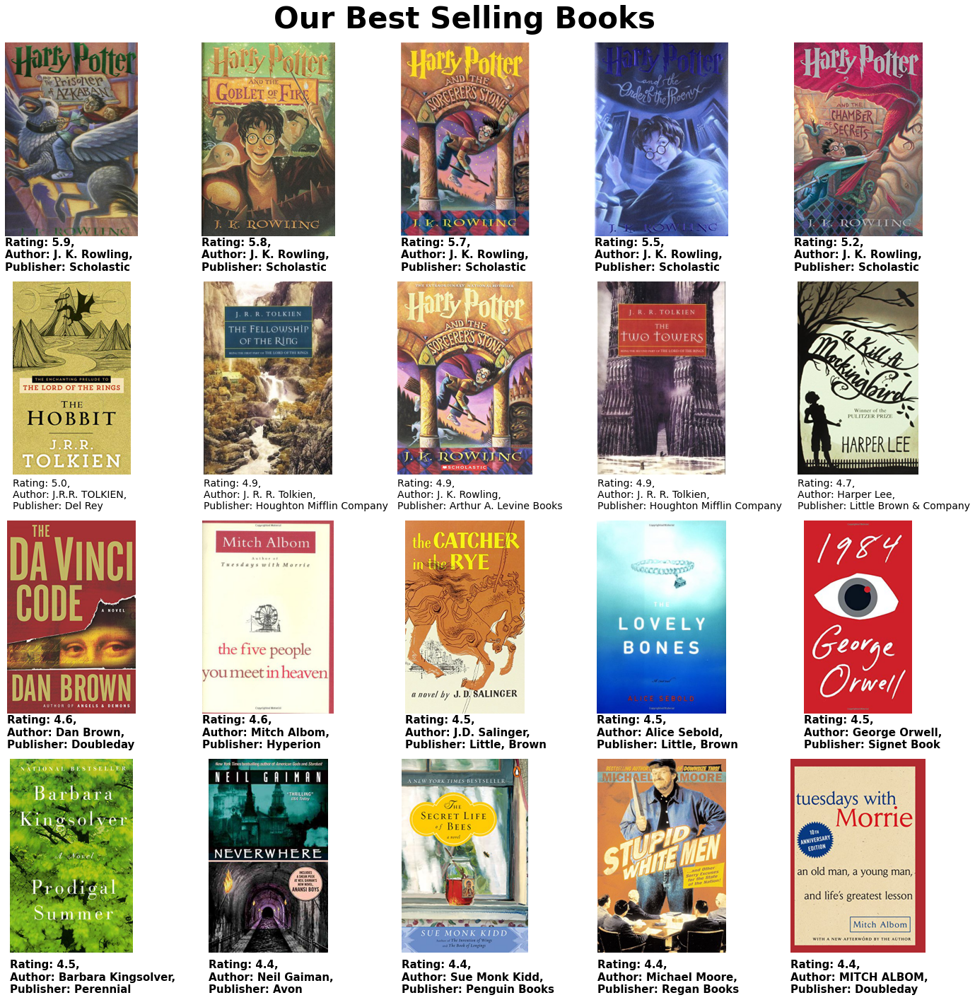

In [177]:
fig, axs = plt.subplots(ncols=5, nrows=4, figsize=(20,20))
fig.suptitle('Our Best Selling Books', size = 42, fontweight='bold')
for i in range(len(twenty_popular_books['book_title'].iloc[:5].tolist())):
    url = twenty_popular_books.loc[twenty_popular_books['book_title'] == twenty_popular_books['book_title'].tolist()[i],'img_l'][:1].values[0]
    im = Image.open(requests.get(url, stream=True).raw)
    axs[0,i].imshow(im)
    axs[0,i].axis("off")
    axs[0,i].set_title('Rating: {}, \nAuthor: {}, \nPublisher: {}'\
                       .format(round(twenty_popular_books['avg_ratings'][i],1),\
                               twenty_popular_books['book_author'][i],\
                              twenty_popular_books['publisher'][i]),\
                        y=-0.20, color="black", fontsize=15, fontweight='bold', loc='left')
    fig.show()
for i in range(len(twenty_popular_books['book_title'].iloc[5:10].tolist())):
    url = twenty_popular_books.loc[twenty_popular_books['book_title'] == twenty_popular_books['book_title'].iloc[5:10].tolist()[i],'img_l'][:1].values[0]
    im = Image.open(requests.get(url, stream=True).raw)
    axs[1,i].imshow(im)
    axs[1,i].axis("off")
    axs[1,i].set_title('Rating: {}, \nAuthor: {}, \nPublisher: {}'\
                       .format(round(twenty_popular_books['avg_ratings'][i+5],1),\
                               twenty_popular_books['book_author'][i+5],\
                              twenty_popular_books['publisher'][i+5]),\
                        y=-0.20, color="black", fontsize=14, loc='left')
    fig.show()
for i in range(len(twenty_popular_books['book_title'].iloc[10:15].tolist())):
    url = twenty_popular_books.loc[twenty_popular_books['book_title'] == twenty_popular_books['book_title'].iloc[10:15].tolist()[i],'img_l'][:1].values[0]
    im = Image.open(requests.get(url, stream=True).raw)
    axs[2,i].imshow(im)
    axs[2,i].axis("off")
    axs[2,i].set_title('Rating: {}, \nAuthor: {}, \nPublisher: {}'\
                       .format(round(twenty_popular_books['avg_ratings'][i+10],1),\
                               twenty_popular_books['book_author'][i+10],\
                              twenty_popular_books['publisher'][i+10]),\
                        y=-0.20, color="black", fontsize=15, fontweight='bold', loc='left')
    fig.show()
for i in range(len(twenty_popular_books['book_title'].iloc[15:20].tolist())):
    url = twenty_popular_books.loc[twenty_popular_books['book_title'] == twenty_popular_books['book_title'].iloc[15:20].tolist()[i],'img_l'][:1].values[0]
    im = Image.open(requests.get(url, stream=True).raw)
    axs[3,i].imshow(im)
    axs[3,i].axis("off")
    axs[3,i].set_title('Rating: {}, \nAuthor: {}, \nPublisher: {}'\
                       .format(round(twenty_popular_books['avg_ratings'][i+15],1),\
                               twenty_popular_books['book_author'][i+15],\
                              twenty_popular_books['publisher'][i+15]),\
                        y=-0.23, color="black", fontsize=15, fontweight='bold', loc='left')
    fig.show()
fig.tight_layout(pad=2.0)
plt.show()

### Pre-Processings<a class="anchor" id="4"></a>

### Data Cleaning

#### Removing Users who have rated less than 50 Books

In [34]:
user_counts = pd.DataFrame(books.groupby('user_id').count()['rating']).rename({'rating':'no_times_rated'}, axis=1).reset_index()
user_counts

,user_id,no_times_rated
0,2,1
1,8,17
2,9,3
3,10,1
4,12,1
...,...,...
92102,278846,1
92103,278849,4
92104,278851,23
92105,278852,1


In [35]:
final_books = pd.merge(books, user_counts, on='user_id')
final_books.drop(columns = ['Unnamed: 0','location','isbn',
                   'img_s','img_l','city','age',
                   'state','Language','country',
                   'year_of_publication'],axis=1,inplace = True) #remove useless cols
final_books.head()

,user_id,rating,book_title,book_author,publisher,img_m,Summary,Category,no_times_rated
0,2,0,Classical Mythology,Mark P. O. Morford,Oxford University Press,http://images.amazon.com/images/P/0195153448.0...,Provides an introduction to classical myths pl...,['Social Science'],1
1,8,5,Clara Callan,Richard Bruce Wright,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,"In a small town in Canada, Clara Callan reluct...",['Actresses'],17
2,8,0,Decision in Normandy,Carlo D'Este,HarperPerennial,http://images.amazon.com/images/P/0060973129.0...,"Here, for the first time in paperback, is an o...",['1940-1949'],17
3,8,0,Flu: The Story of the Great Influenza Pandemic...,Gina Bari Kolata,Farrar Straus Giroux,http://images.amazon.com/images/P/0374157065.0...,"Describes the great flu epidemic of 1918, an o...",['Medical'],17
4,8,0,The Mummies of Urumchi,E. J. W. Barber,W. W. Norton & Company,http://images.amazon.com/images/P/0393045218.0...,A look at the incredibly well-preserved ancien...,['Design'],17


In [36]:
final_books.user_id.nunique()

92107

In [37]:
final_books = final_books[final_books['no_times_rated']>=50].reset_index(drop=True)
final_books

,user_id,rating,book_title,book_author,publisher,img_m,Summary,Category,no_times_rated
0,11400,0,Clara Callan,Richard Bruce Wright,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,"In a small town in Canada, Clara Callan reluct...",['Actresses'],62
1,11400,0,Winter Solstice,Rosamunde Pilcher,St. Martin's Paperbacks,http://images.amazon.com/images/P/0312978383.0...,9,9,62
2,11400,9,The Five People You Meet in Heaven,Mitch Albom,Hyperion,http://images.amazon.com/images/P/0786868716.0...,"With a timeless tale, appealing to all, this i...",['Fiction'],62
3,11400,0,House of Sand and Fog,Andre Dubus III,Vintage Books,http://images.amazon.com/images/P/0375727345.0...,9,9,62
4,11400,6,Life of Pi,Yann Martel,Harcourt,http://images.amazon.com/images/P/0151008116.0...,"After the sinking of a cargo ship, a solitary ...",['Fiction'],62
...,...,...,...,...,...,...,...,...,...
690282,203074,10,England a Picture Book to Remember Her B,Ted Smart,Crescent Books,http://images.amazon.com/images/P/0904681351.0...,9,9,63
690283,203074,10,"Above Los Angeles, Revised Edition",Robert Cameron,Cameron & Company,http://images.amazon.com/images/P/091868448X.0...,9,9,63
690284,203074,10,Handy Weather Answer Book,Walter A Lyons,Visible Ink Press,http://images.amazon.com/images/P/157859054X.0...,What is space junk? Is there weather on other ...,['Weather'],63
690285,203074,10,New York,Costanza Poli,MetroBooks,http://images.amazon.com/images/P/1586635964.0...,9,9,63


In [38]:
final_books.user_id.nunique()

3058

In [39]:
final_books.sort_values('no_times_rated', ascending=False)

,user_id,rating,book_title,book_author,publisher,img_m,Summary,Category,no_times_rated
7186,11676,6,Scruples Two,Judith Krantz,Bantam Books,http://images.amazon.com/images/P/0553561111.0...,"Picking up where Scruples left off, the sequel...",['Fiction'],11144
7476,11676,6,Equal Rites (Discworld Novels (Paperback)),Terry Pratchett,Sagebrush Bound,http://images.amazon.com/images/P/0613278089.0...,9,9,11144
7468,11676,0,Eat Cake : A Novel,JEANNE RAY,Shaye Areheart Books,http://images.amazon.com/images/P/060961004X.0...,9,9,11144
7469,11676,6,"Horseshoes, Cowsocks, & Duckfeet: More Comment...",Baxter Black,Crown Publishers,http://images.amazon.com/images/P/0609610902.0...,9,9,11144
7470,11676,0,9 Steps to Financial Freedom: Practical and Sp...,Suze Orman,Three Rivers Press,http://images.amazon.com/images/P/0609801864.0...,The best-selling author of The Courage to Be R...,['Business & Economics'],11144
...,...,...,...,...,...,...,...,...,...
192242,1025,8,Shadowheart : Legends of the Raven (Legends of...,James Barclay,Gollancz,http://images.amazon.com/images/P/0575073314.0...,The second of James Barclay s Legends of The R...,['Fiction'],50
192241,1025,8,Nightchild (Gollancz SF S.),James Barclay,Gollancz,http://images.amazon.com/images/P/0575073004.0...,9,9,50
192240,1025,7,Away from It All,Judy Astley,Trafalgar Square,http://images.amazon.com/images/P/0552999512.0...,Alice lives a well ordered life with her secon...,['Fiction'],50
192239,1025,8,Unchained Melanie,Judy Astley,Trafalgar Square,http://images.amazon.com/images/P/0552999504.0...,Melanie finds herself single again after years...,['Fiction'],50


In [40]:
final_books[final_books.duplicated()]

,user_id,rating,book_title,book_author,publisher,img_m,Summary,Category,no_times_rated


In [41]:
final_books.duplicated().sum()

0

In [42]:
final_books.isnull().sum()

user_id           0
rating            0
book_title        0
book_author       0
publisher         0
img_m             0
Summary           0
Category          0
no_times_rated    0
dtype: int64

#### Removing Books with less than 50 number of User Ratings

In [43]:
book_counts = pd.DataFrame(final_books.groupby('book_title').count()['rating']).reset_index().rename({'rating':'no_times_rated'}, axis=1)
book_counts

,book_title,no_times_rated
0,A Light in the Storm: The Civil War Diary of ...,4
1,Always Have Popsicles,1
2,Apple Magic (The Collector's series),1
3,"Ask Lily (Young Women of Faith: Lily Series, ...",1
4,Beyond IBM: Leadership Marketing and Finance ...,1
...,...,...
195903,Ã?Â?berraschung am Valentinstag.,1
195904,Ã?Â?lpiraten.,1
195905,Ã?Â?rger mit Produkt X. Roman.,3
195906,Ã?Â?stlich der Berge.,1


In [44]:
final_books.drop('no_times_rated', axis=1, inplace=True)
final_book = pd.merge(final_books, book_counts, on='book_title')
final_book.head()

,user_id,rating,book_title,book_author,publisher,img_m,Summary,Category,no_times_rated
0,11400,0,Clara Callan,Richard Bruce Wright,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,"In a small town in Canada, Clara Callan reluct...",['Actresses'],8
1,11676,8,Clara Callan,Richard Bruce Wright,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,"In a small town in Canada, Clara Callan reluct...",['Actresses'],8
2,85526,0,Clara Callan,Richard Bruce Wright,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,"In a small town in Canada, Clara Callan reluct...",['Actresses'],8
3,96054,0,Clara Callan,Richard Bruce Wright,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,"In a small town in Canada, Clara Callan reluct...",['Actresses'],8
4,116866,9,Clara Callan,Richard Bruce Wright,HarperFlamingo Canada,http://images.amazon.com/images/P/0002005018.0...,"In a small town in Canada, Clara Callan reluct...",['Actresses'],8


In [45]:
final_book.book_title.nunique()

195908

In [46]:
final_book = final_book[final_book['no_times_rated']>=50].reset_index(drop=True)
final_book

,user_id,rating,book_title,book_author,publisher,img_m,Summary,Category,no_times_rated
0,11400,0,Winter Solstice,Rosamunde Pilcher,St. Martin's Paperbacks,http://images.amazon.com/images/P/0312978383.0...,9,9,99
1,11676,5,Winter Solstice,Rosamunde Pilcher,St. Martin's Paperbacks,http://images.amazon.com/images/P/0312978383.0...,9,9,99
2,230522,0,Winter Solstice,Rosamunde Pilcher,St. Martin's Paperbacks,http://images.amazon.com/images/P/0312978383.0...,9,9,99
3,245827,0,Winter Solstice,Rosamunde Pilcher,Thomas Dunne Books,http://images.amazon.com/images/P/0312244266.0...,Five people buffeted by life&#39;s difficultie...,['Fiction'],99
4,16795,6,Winter Solstice,Rosamunde Pilcher,St. Martin's Paperbacks,http://images.amazon.com/images/P/0312978383.0...,9,9,99
...,...,...,...,...,...,...,...,...,...
132706,72451,0,Lady of Avalon,Marion Zimmer Bradley,Penguin Books Ltd,http://images.amazon.com/images/P/0140241930.0...,"The story is told from the time when Gawen, he...",['Arthurian romances'],53
132707,128610,0,Lady of Avalon,Marion Zimmer Bradley,Viking Books,http://images.amazon.com/images/P/0670857831.0...,9,9,53
132708,73127,0,Lady of Avalon,Marion Zimmer Bradley,Viking Books,http://images.amazon.com/images/P/0670857831.0...,9,9,53
132709,2033,0,Lady of Avalon,Marion Zimmer Bradley,Roc,http://images.amazon.com/images/P/0451456521.0...,The author of The Mists of Avalon delves into ...,['Fiction'],53


In [47]:
final_book.book_title.nunique()

1360

#### Removing Books with '0' Ratings

In [48]:
df = final_book.copy()
# df.dropna(inplace=True)

# df.drop(columns = ['Unnamed: 0','location','isbn',
#                    'img_s','img_m','city','age',
#                    'state','Language','country',
#                    'year_of_publication'],axis=1,inplace = True) #remove useless cols

# df.drop(index=df[df['Category'] == '9'].index, inplace=True) #remove 9 in category

df.drop(index=df[df['rating'] == 0].index, inplace=True) #remove 0 in rating

df['Category'] = df['Category'].apply(lambda x: re.sub('[\W_]+',' ',x).strip())

df.reset_index(drop=True, inplace=True)

df.head()

,user_id,rating,book_title,book_author,publisher,img_m,Summary,Category,no_times_rated
0,11676,5,Winter Solstice,Rosamunde Pilcher,St. Martin's Paperbacks,http://images.amazon.com/images/P/0312978383.0...,9,9,99
1,16795,6,Winter Solstice,Rosamunde Pilcher,St. Martin's Paperbacks,http://images.amazon.com/images/P/0312978383.0...,9,9,99
2,115003,7,Winter Solstice,Rosamunde Pilcher,St. Martin's Paperbacks,http://images.amazon.com/images/P/0312978383.0...,9,9,99
3,190741,7,Winter Solstice,Rosamunde Pilcher,St. Martin's Paperbacks,http://images.amazon.com/images/P/0312978383.0...,9,9,99
4,218121,8,Winter Solstice,Rosamunde Pilcher,St. Martin's Paperbacks,http://images.amazon.com/images/P/0312978383.0...,9,9,99


In [49]:
df[df['Category']=='9']

,user_id,rating,book_title,book_author,publisher,img_m,Summary,Category,no_times_rated
0,11676,5,Winter Solstice,Rosamunde Pilcher,St. Martin's Paperbacks,http://images.amazon.com/images/P/0312978383.0...,9,9,99
1,16795,6,Winter Solstice,Rosamunde Pilcher,St. Martin's Paperbacks,http://images.amazon.com/images/P/0312978383.0...,9,9,99
2,115003,7,Winter Solstice,Rosamunde Pilcher,St. Martin's Paperbacks,http://images.amazon.com/images/P/0312978383.0...,9,9,99
3,190741,7,Winter Solstice,Rosamunde Pilcher,St. Martin's Paperbacks,http://images.amazon.com/images/P/0312978383.0...,9,9,99
4,218121,8,Winter Solstice,Rosamunde Pilcher,St. Martin's Paperbacks,http://images.amazon.com/images/P/0312978383.0...,9,9,99
...,...,...,...,...,...,...,...,...,...
39476,260944,10,The Eyes of the Dragon,Stephen King,Signet Book,http://images.amazon.com/images/P/0451166582.0...,9,9,73
39477,184532,10,The Eyes of the Dragon,Stephen King,Signet Book,http://images.amazon.com/images/P/0451166582.0...,9,9,73
39494,129465,6,Shadows,Jonathan Nasaw,Signet Book,http://images.amazon.com/images/P/0451186591.0...,9,9,56
39497,154469,10,Shadows,John Saul,Bantam Dell Pub Group,http://images.amazon.com/images/P/0553074741.0...,9,9,56


In [50]:
df

,user_id,rating,book_title,book_author,publisher,img_m,Summary,Category,no_times_rated
0,11676,5,Winter Solstice,Rosamunde Pilcher,St. Martin's Paperbacks,http://images.amazon.com/images/P/0312978383.0...,9,9,99
1,16795,6,Winter Solstice,Rosamunde Pilcher,St. Martin's Paperbacks,http://images.amazon.com/images/P/0312978383.0...,9,9,99
2,115003,7,Winter Solstice,Rosamunde Pilcher,St. Martin's Paperbacks,http://images.amazon.com/images/P/0312978383.0...,9,9,99
3,190741,7,Winter Solstice,Rosamunde Pilcher,St. Martin's Paperbacks,http://images.amazon.com/images/P/0312978383.0...,9,9,99
4,218121,8,Winter Solstice,Rosamunde Pilcher,St. Martin's Paperbacks,http://images.amazon.com/images/P/0312978383.0...,9,9,99
...,...,...,...,...,...,...,...,...,...
39514,271705,9,Lady of Avalon,Marion Zimmer Bradley,Roc,http://images.amazon.com/images/P/0451456521.0...,The author of The Mists of Avalon delves into ...,Fiction,53
39515,30735,8,Lady of Avalon,Marion Zimmer Bradley,Viking Books,http://images.amazon.com/images/P/0670857831.0...,9,9,53
39516,123215,7,Lady of Avalon,Marion Zimmer Bradley,Roc,http://images.amazon.com/images/P/0451456521.0...,The author of The Mists of Avalon delves into ...,Fiction,53
39517,95921,8,Lady of Avalon,Marion Zimmer Bradley,Penguin Books Ltd,http://images.amazon.com/images/P/0140241930.0...,"The story is told from the time when Gawen, he...",Arthurian romances,53


In [51]:
df[df.duplicated()]

,user_id,rating,book_title,book_author,publisher,img_m,Summary,Category,no_times_rated


In [52]:
df.isnull().sum()

user_id           0
rating            0
book_title        0
book_author       0
publisher         0
img_m             0
Summary           0
Category          0
no_times_rated    0
dtype: int64

In [53]:
df.user_id.nunique()

2766

In [54]:
df.book_title.nunique()

1360

In [56]:
df.img_m[1]

'http://images.amazon.com/images/P/0312978383.01.MZZZZZZZ.jpg'

### Recommendation System - Part II
#### Model-based collaborative filtering system
Recommend items to users based on purchase history and similarity of ratings provided by other users who bought items to that of a particular customer.
A model based collaborative filtering technique is chosen here as it helps in recommending products for a particular user by identifying patterns based on preferences from multiple user’s data.

#### Utility Matrix based on products sold and user reviews
**Utility Matrix :** An utility matrix is consists of all possible user-item preferences (ratings) details represented as a matrix. The utility matrix is sparce as none of the users would buy all the items in the list, hence, most of the values are unknown.

In [41]:
pivot_tables = df.pivot_table(index='book_title', columns='user_id',values='rating').fillna(0)
pivot_tables

user_id,243,254,507,638,643,741,882,929,1025,1211,...,277639,277928,277965,278026,278137,278188,278418,278582,278633,278843
book_title,,,,,,,,,,,,,,,,,,,,,
1984,0.0,9.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1st to Die: A Novel,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2010: Odyssey Two,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
204 Rosewood Lane,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
24 Hours,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Year of Wonders,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
You Belong To Me,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Zen and the Art of Motorcycle Maintenance: An Inquiry into Values,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [43]:
cosine_similarity(pivot_tables).shape

(1360, 1360)

In [45]:
similarity = cosine_similarity(pivot_tables)
similarity

array([[1.        , 0.05537759, 0.06202096, ..., 0.0693197 , 0.06053833,
        0.03542703],
       [0.05537759, 1.        , 0.01662507, ..., 0.03752042, 0.12514541,
        0.09872022],
       [0.06202096, 0.01662507, 1.        , ..., 0.07303747, 0.        ,
        0.        ],
       ...,
       [0.0693197 , 0.03752042, 0.07303747, ..., 1.        , 0.04144573,
        0.02135803],
       [0.06053833, 0.12514541, 0.        , ..., 0.04144573, 1.        ,
        0.08119057],
       [0.03542703, 0.09872022, 0.        , ..., 0.02135803, 0.08119057,
        1.        ]])

In [56]:
# Store the results in a dataframe
user_sim_df = pd.DataFrame(similarity, columns = pivot_tables.index, index = pivot_tables.index)
user_sim_df

book_title,1984,1st to Die: A Novel,2010: Odyssey Two,204 Rosewood Lane,24 Hours,2nd Chance,4 Blondes,84 Charing Cross Road,A 2nd Helping of Chicken Soup for the Soul (Chicken Soup for the Soul Series (Paper)),A Beautiful Mind: The Life of Mathematical Genius and Nobel Laureate John Nash,...,Women Who Run with the Wolves,"Word Freak: Heartbreak, Triumph, Genius, and Obsession in the World of Competitive Scrabble Players",Writ of Execution,Wuthering Heights,Wuthering Heights (Penguin Classics),Year of Wonders,You Belong To Me,Zen and the Art of Motorcycle Maintenance: An Inquiry into Values,Zoya,"\O\"" Is for Outlaw"""
book_title,,,,,,,,,,,,,,,,,,,,,
1984,1.000000,0.055378,0.062021,0.0,0.040089,0.016380,0.000000,0.062858,0.024466,0.031866,...,0.021668,0.139080,0.045072,0.052269,0.000000,0.050504,0.024080,0.069320,0.060538,0.035427
1st to Die: A Novel,0.055378,1.000000,0.016625,0.0,0.102020,0.227036,0.000000,0.017955,0.040990,0.000000,...,0.039810,0.044655,0.090680,0.056895,0.000000,0.043891,0.126514,0.037520,0.125145,0.098720
2010: Odyssey Two,0.062021,0.016625,1.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.035360,0.000000,0.050630,0.000000,0.029127,0.000000,0.073037,0.000000,0.000000
204 Rosewood Lane,0.000000,0.000000,0.000000,1.0,0.000000,0.104643,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.077305,0.086380,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
24 Hours,0.040089,0.102020,0.000000,0.0,1.000000,0.076340,0.000000,0.042171,0.000000,0.000000,...,0.000000,0.047997,0.089385,0.057270,0.000000,0.000000,0.047755,0.046265,0.101745,0.036702
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Year of Wonders,0.050504,0.043891,0.029127,0.0,0.000000,0.036761,0.057569,0.000000,0.000000,0.000000,...,0.000000,0.063225,0.000000,0.030378,0.000000,1.000000,0.000000,0.000000,0.048573,0.000000
You Belong To Me,0.024080,0.126514,0.000000,0.0,0.047755,0.088892,0.040429,0.025331,0.000000,0.000000,...,0.000000,0.028830,0.053691,0.080268,0.000000,0.000000,1.000000,0.027790,0.116119,0.117053
Zen and the Art of Motorcycle Maintenance: An Inquiry into Values,0.069320,0.037520,0.073037,0.0,0.046265,0.023945,0.025179,0.024541,0.000000,0.000000,...,0.000000,0.027931,0.052016,0.033327,0.039908,0.000000,0.027790,1.000000,0.041446,0.021358


In [63]:
np.where(pivot_tables.index=='1984')[0][0]

0

In [93]:
sorted(list(enumerate(similarity[0])),key = lambda x:x[1], reverse=True)[1:21]

[(90, 0.23214272519288343),
 (156, 0.1918986344535819),
 (1226, 0.15817070556092744),
 (1049, 0.15784920058136329),
 (76, 0.15389089840528014),
 (834, 0.15387573992884304),
 (759, 0.15004902385952207),
 (911, 0.1497317202392809),
 (1260, 0.1496818877272505),
 (900, 0.14539693052385028),
 (1054, 0.1414377665110215),
 (957, 0.1404066972414526),
 (1351, 0.13908028777085385),
 (628, 0.13565498198445314),
 (730, 0.13493922901878147),
 (918, 0.12891059390805093),
 (340, 0.1281738156311917),
 (1205, 0.12749154632446483),
 (563, 0.12639564906119796),
 (1337, 0.12180255648138336)]

In [149]:
list(enumerate(similarity[0]))[1:16]

[(1, 0.05537759351171197),
 (2, 0.06202095770122161),
 (3, 0.0),
 (4, 0.04008861862977904),
 (5, 0.016380329814298888),
 (6, 0.0),
 (7, 0.0628579600087067),
 (8, 0.024466344793889577),
 (9, 0.03186649645408932),
 (10, 0.033795406357393344),
 (11, 0.09283168031465586),
 (12, 0.04789116676819609),
 (13, 0.07349609388195488),
 (14, 0.03200005923169787),
 (15, 0.0)]

In [83]:
pivot_tables.index[90]

'Animal Farm'

In [98]:
def recommend(book_name):
    index = np.where(pivot_tables.index==book_name)[0][0]
    similar_items = sorted(list(enumerate(similarity[index])),key = lambda x:x[1], reverse=True)[1:20]
    
    for i in similar_items:
        print(pivot_tables.index[i[0]])

In [102]:
recommend('Message in a Bottle')

Nights in Rodanthe
A Walk to Remember
The Notebook
The Rescue
A Bend in the Road
Suzanne's Diary for Nicholas
River's End
The Guardian
The Ranch
The Mulberry Tree
The Wedding
Three Wishes
The Gift
Angel Falls
Sanctuary
Chocolat
Nightmares & Dreamscapes
Genuine Lies
I Know Why the Caged Bird Sings


In [103]:
recommend('The Notebook')

Message in a Bottle
The Rescue
A Walk to Remember
Nights in Rodanthe
Suzanne's Diary for Nicholas
The Five People You Meet in Heaven
The Ranch
The Wedding
Small Town Girl
The Gift
Toxin
GARDEN OF SHADOWS (Dollanger Saga (Paperback))
Accident
The Lovely Bones: A Novel
While I Was Gone
Cloud Nine
One Door Away from Heaven
The Guardian
A Bend in the Road


In [104]:
recommend('1984')

Animal Farm
Brave New World
The Vampire Lestat (Vampire Chronicles, Book II)
The Handmaid's Tale
American Psycho (Vintage Contemporaries)
Slaughterhouse Five or the Children's Crusade: A Duty Dance With Death
Roll of Thunder, Hear My Cry
The Autobiography of Malcolm X
Timeline
The Alchemist: A Fable About Following Your Dream
The Hitchhiker's Guide to the Galaxy
The Catcher in the Rye
Word Freak: Heartbreak, Triumph, Genius, and Obsession in the World of Competitive Scrabble Players
Naked
Puerto Vallarta Squeeze
The Beach
Fahrenheit 451
The Sweet Potato Queens' Book of Love
Lord of the Flies


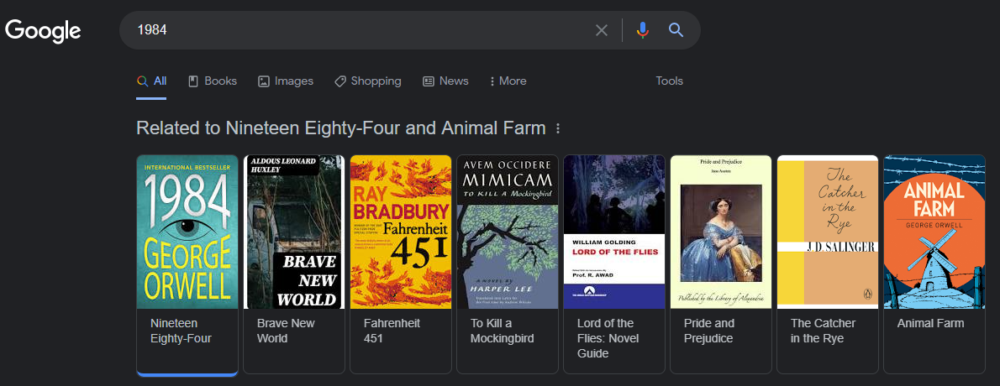

In [106]:
recommend('Fahrenheit 451')

The Hitchhiker's Guide to the Galaxy
Brave New World
On the Road
Harry Potter and the Sorcerer's Stone (Harry Potter (Paperback))
James and the Giant Peach
1984
STONES FROM THE RIVER
The Catcher in the Rye
Jane Eyre
Puerto Vallarta Squeeze
A Separate Peace
Where Are the Children?
The Corrections
The Scarlet Letter
I'll Take Manhattan
Lord of the Flies
Jane Eyre (Bantam Classics)
Slaughterhouse Five or the Children's Crusade: A Duty Dance With Death
Pride and Prejudice


In [107]:
recommend('The Da Vinci Code')

Angels & Demons
Middlesex: A Novel
The Lovely Bones: A Novel
Digital Fortress : A Thriller
The Secret Life of Bees
Touching Evil
The Blue Nowhere : A Novel
Bleachers
The Sweet Potato Queens' Book of Love
Deception Point
TickTock
Timeline
The Last Juror
Catch Me If You Can: The True Story of a Real Fake
The Red Tent (Bestselling Backlist)
The Lake House
The Face
The Chamber
The Crimson Petal and the White


In [108]:
recommend('The Hobbit : The Enchanting Prelude to The Lord of the Rings')

The Return of the King (The Lord of the Rings, Part 3)
The Fellowship of the Ring (The Lord of the Rings, Part 1)
The Two Towers (The Lord of the Rings, Part 2)
Harry Potter and the Chamber of Secrets (Book 2)
Lord of the Flies
Stuart Little
Harry Potter and the Prisoner of Azkaban (Book 3)
Left Behind: A Novel of the Earth's Last Days (Left Behind No. 1)
The English Patient
Harry Potter and the Goblet of Fire (Book 4)
Harry Potter and the Sorcerer's Stone (Harry Potter (Paperback))
The Catcher in the Rye
Where the Red Fern Grows
The Indian in the Cupboard
Harry Potter and the Sorcerer's Stone (Book 1)
Eaters of the Dead
The Cider House Rules
One for the Money (A Stephanie Plum Novel)
2010: Odyssey Two


In [109]:
recommend('Harry Potter and the Goblet of Fire (Book 4)')

Harry Potter and the Prisoner of Azkaban (Book 3)
Harry Potter and the Chamber of Secrets (Book 2)
Harry Potter and the Order of the Phoenix (Book 5)
Harry Potter and the Sorcerer's Stone (Book 1)
Harry Potter and the Sorcerer's Stone (Harry Potter (Paperback))
The Fellowship of the Ring (The Lord of the Rings, Part 1)
The Two Towers (The Lord of the Rings, Part 2)
Bridget Jones's Diary
The Bad Beginning (A Series of Unfortunate Events, Book 1)
The Secret Garden
A Walk to Remember
The Return of the King (The Lord of the Rings, Part 3)
Charlotte's Web (Trophy Newbery)
Heartbeat
The Catcher in the Rye
Me Talk Pretty One Day
Naked in Death
Star
Firestarter


In [26]:
def recommend(book_name):
    pivot_tables = df.pivot_table(index='book_title', columns='user_id',values='rating').fillna(0)
    index = np.where(pivot_tables.index==book_name)[0][0]
    similarity = cosine_similarity(pivot_tables)
    similar_items = sorted(list(enumerate(similarity[index])),key = lambda x:x[1], reverse=True)[1:20]
    
    for i in similar_items:
        print(pivot_tables.index[i[0]])

In [27]:
recommend('1984')

Animal Farm
Brave New World
The Vampire Lestat (Vampire Chronicles, Book II)
The Handmaid's Tale
American Psycho (Vintage Contemporaries)
Slaughterhouse Five or the Children's Crusade: A Duty Dance With Death
Roll of Thunder, Hear My Cry
The Autobiography of Malcolm X
Timeline
The Alchemist: A Fable About Following Your Dream
The Hitchhiker's Guide to the Galaxy
The Catcher in the Rye
Word Freak: Heartbreak, Triumph, Genius, and Obsession in the World of Competitive Scrabble Players
Naked
Puerto Vallarta Squeeze
The Beach
Fahrenheit 451
The Sweet Potato Queens' Book of Love
Lord of the Flies


In [57]:
def recommend(book_name):
    pivot_tables = df.pivot_table(index='book_title', columns='user_id',values='rating').fillna(0)
    index = np.where(pivot_tables.index==book_name)[0][0]
    similarity = cosine_similarity(pivot_tables)
    similar_items = sorted(list(enumerate(similarity[index])),key = lambda x:x[1], reverse=True)[1:20]
    
    data = []
    for i in similar_items:
        item = []
        temp_df = df[df['book_title'] == pivot_tables.index[i[0]]]
        item.extend(list(temp_df.drop_duplicates('book_title')['book_title'].values))
        item.extend(list(temp_df.drop_duplicates('book_title')['book_author'].values))
        item.extend(list(temp_df.drop_duplicates('book_title')['img_m'].values))
        
        data.append(item)
    return data

In [58]:
recommend('1984')

[['Animal Farm',
  'George Orwell',
  'http://images.amazon.com/images/P/0451526341.01.MZZZZZZZ.jpg'],
 ['Brave New World',
  'Aldous Huxley',
  'http://images.amazon.com/images/P/0060809833.01.MZZZZZZZ.jpg'],
 ['The Vampire Lestat (Vampire Chronicles, Book II)',
  'ANNE RICE',
  'http://images.amazon.com/images/P/0345313860.01.MZZZZZZZ.jpg'],
 ["The Handmaid's Tale",
  'Margaret Atwood',
  'http://images.amazon.com/images/P/0449212602.01.MZZZZZZZ.jpg'],
 ['American Psycho (Vintage Contemporaries)',
  'Bret Easton Ellis',
  'http://images.amazon.com/images/P/0679735771.01.MZZZZZZZ.jpg'],
 ["Slaughterhouse Five or the Children's Crusade: A Duty Dance With Death",
  'Kurt Vonnegut',
  'http://images.amazon.com/images/P/0440180295.01.MZZZZZZZ.jpg'],
 ['Roll of Thunder, Hear My Cry',
  'Mildred D. Taylor',
  'http://images.amazon.com/images/P/014034893X.01.MZZZZZZZ.jpg'],
 ['The Autobiography of Malcolm X',
  'Malcolm X',
  'http://images.amazon.com/images/P/0345379756.01.MZZZZZZZ.jpg'],
 

### Item-Based Collaborative Filterings<a class="anchor" id="5"></a>

* **Item Based Collaborative Filtering** - Instead of measuring the similarity between users, the item-based CF recommends items based on their similarity with the items that the target user rated. Likewise, the similarity can be computed with Pearson Correlation or Cosine Similarity. The major difference is that, with item-based collaborative filtering, we fill in the blank vertically, as oppose to the horizontal manner that user-based CF does.

![](https://image.ibb.co/f6mDXU/conten.png)

### **Using Cosine Similarity**
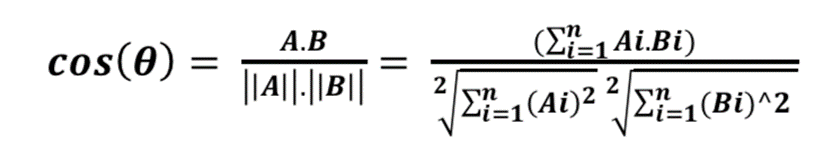
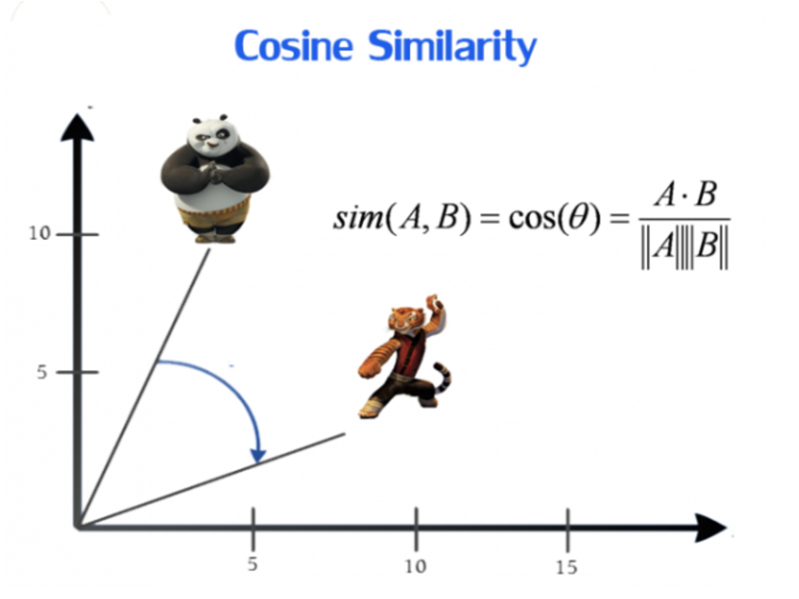

In [302]:
def item_based_recommender(book_title):
    
    book_title = str(book_title)
    if book_title in df['book_title'].values:
            
        user_book_df = df.pivot_table(index=['book_title'],
                                                    columns=['user_id'],
                                                    values='rating').fillna(0)
        
        cosine_sim = cosine_similarity(user_book_df)
        index = np.where(user_book_df.index == book_title)[0][0]
        sim_books = list(enumerate(cosine_sim[index]))
        sorted_sim_books = sorted(sim_books,key=lambda x:x[1],
                                      reverse=True)[1:6]
            
        books = []
        for i in sorted_sim_books:
            books.append(user_book_df.index[i[0]])
        
        fig = plt.figure(figsize=(18,5),dpi=100)
        url = df.loc[df['book_title'] == book_title,'img_l'][:1].values[0]
        im = Image.open(requests.get(url, stream=True).raw)
        plt.imshow(im)
        plt.axis('off')
        plt.title('Rating: {}, \nAuthor: {}'\
                       .format(round(df[df['book_title'] == book_title]['rating'].mean(),1),\
                               df['book_author'][df['book_title']== book_title].values[0]),\
                        y=-0.20, color="black", fontsize=14, fontweight='bold', loc='left')
        plt.show()
            
        fig, axs = plt.subplots(1, 5,figsize=(18,5))
        fig.suptitle('Users who searched for '+ book_title +' also searched for these books', size = 22)
        for i in range(len(books)):
        
            url = df.loc[df['book_title'] == books[i],'img_l'][:1].values[0]
            im = Image.open(requests.get(url, stream=True).raw)
            axs[i].imshow(im)
            axs[i].axis("off")
            axs[i].set_title('Rating: {}, \nAuthor: {}'\
                       .format(round(df[df['book_title'] == books[i]]['rating'].mean(),1),\
                               df['book_author'][df['book_title']== books[i]].values[0]),\
                        y=-0.20, color="black", fontsize=14, fontweight='bold', loc='left')
                
            fig.tight_layout()
            fig.show()
                     
    else:
        random = pd.Series(df['book_title'].unique()).sample(2).values
        print('Cant find book in dataset, please check spelling \n')
        print('Try: \n')
        print('{}'.format(random[0]),'\n')
        print('{}'.format(random[1]),'\n')
        print('{}'.format(random[2]),'\n')

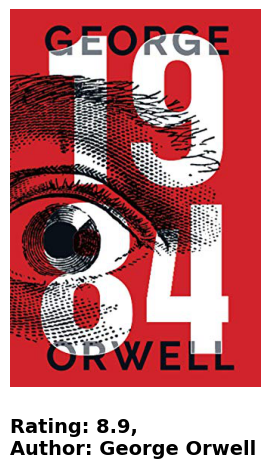

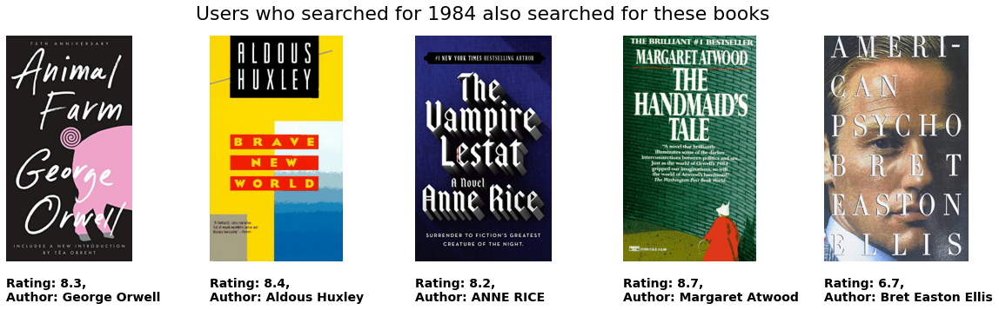

In [303]:
item_based_recommender('1984')

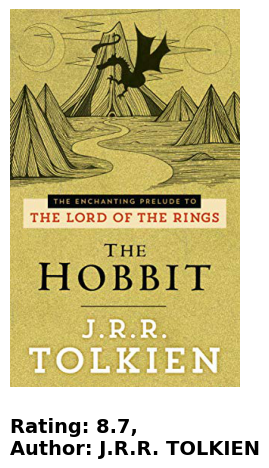

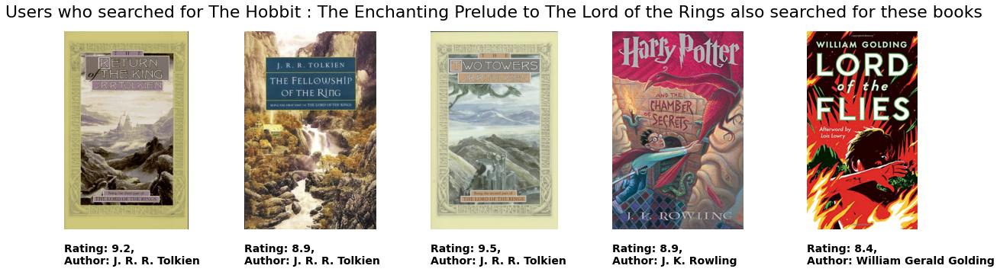

In [304]:
item_based_recommender('The Hobbit : The Enchanting Prelude to The Lord of the Rings')

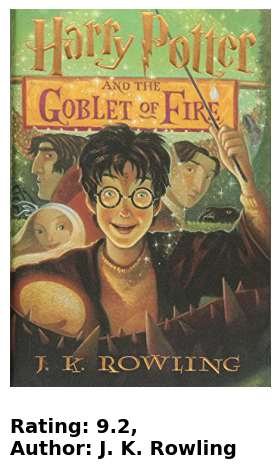

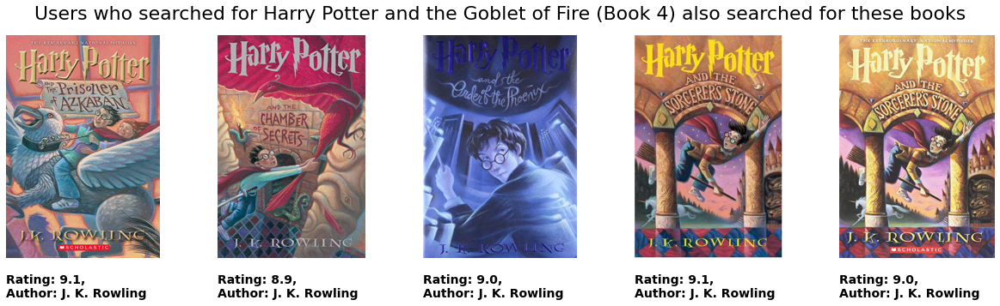

In [305]:
item_based_recommender('Harry Potter and the Goblet of Fire (Book 4)')

In [300]:
def item_based_recommender(book_title):
    
    book_title = str(book_title)
    if book_title in df['book_title'].values:
            
        user_book_df = df.pivot_table(index=['book_title'],
                                                    columns=['user_id'],
                                                    values='rating').fillna(0)
        
        cosine_sim = cosine_similarity(user_book_df)
        index = np.where(user_book_df.index == book_title)[0][0]
        sim_books = list(enumerate(cosine_sim[index]))
        sorted_sim_books = sorted(sim_books,key=lambda x:x[1],
                                      reverse=True)[1:16]
            
        books = []
        for i in sorted_sim_books:
            books.append(user_book_df.index[i[0]])
        
        fig = plt.figure(figsize=(18,5),dpi=100)
        url = df.loc[df['book_title'] == book_title,'img_l'][:1].values[0]
        im = Image.open(requests.get(url, stream=True).raw)
        plt.imshow(im)
        plt.axis('off')
        plt.title('Rating: {}, \nAuthor: {}'\
                       .format(round(df[df['book_title'] == book_title]['rating'].mean(),1),\
                               df['book_author'][df['book_title']== book_title].values[0]),\
                        y=-0.20, color="black", fontsize=14, fontweight='bold', loc='left')
        plt.show()
        plt.suptitle('Users who searched for '+ book_title +' also searched for these books', size = 22)
        for i in range(len(books)):
            fig.add_subplot(4, 5, i+1)
            url = df.loc[df['book_title'] == books[i],'img_l'][:1].values[0]
            im = Image.open(requests.get(url, stream=True).raw)
            plt.imshow(im)
            plt.axis('off')
            plt.title('Rating: {}, \nAuthor: {}'\
                       .format(round(df[df['book_title'] == books[i]]['rating'].mean(),1),\
                               df['book_author'][df['book_title']== books[i]].values[0]),\
                        y=-0.20, color="black", fontsize=14, fontweight='bold', loc='left')
            plt.show()
                     
    else:
        random = pd.Series(df['book_title'].unique()).sample(2).values
        print('Cant find book in dataset, please check spelling \n')
        print('Try: \n')
        print('{}'.format(random[0]),'\n')
        print('{}'.format(random[1]),'\n')
        print('{}'.format(random[2]),'\n')

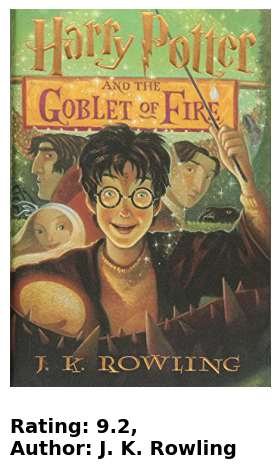

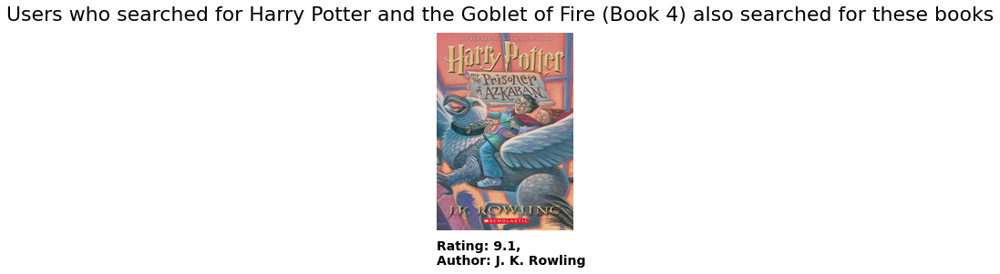

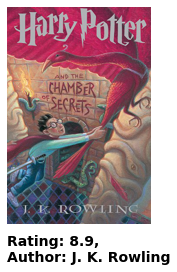

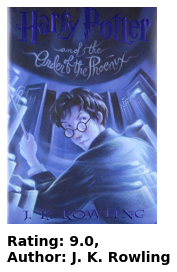

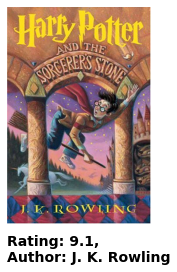

...

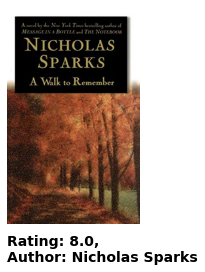

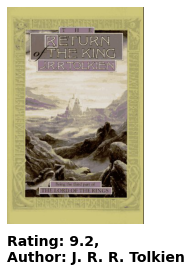

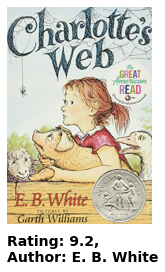

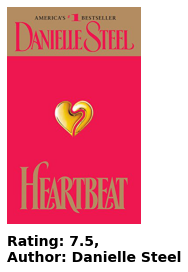

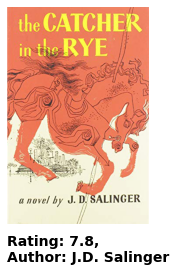

In [301]:
item_based_recommender('Harry Potter and the Goblet of Fire (Book 4)')

## Using Correlation 

In [46]:
def item_based_recommender(book_title):
    
    book_title = str(book_title)
    if book_title in df['book_title'].values:
    
        rating_counts = pd.DataFrame(df['book_title'].value_counts())
        rare_books = rating_counts[rating_counts['book_title'] <= 50].index
        common_books = df[~df['book_title'].isin(rare_books)]
        
        if book_title in rare_books:
            
            random = pd.Series(common_books['book_title'].unique()).sample(2).values
            print('There are no recommendations for this book')
            print('Try: \n')
            print('{}'.format(random[0]),'\n')
            print('{}'.format(random[1]),'\n')
            print('{}'.format(random[2]),'\n')
        
        else:
            user_book_df = common_books.pivot_table(index=['user_id'],
                                                    columns=['book_title'],
                                                    values='rating')
        
            book = user_book_df[book_title]
            recom_data = pd.DataFrame(user_book_df.corrwith(book). \
                                      sort_values(ascending=False)).reset_index(drop=False)
            
            if book_title in [book for book in recom_data['book_title']]:
                recom_data = recom_data.drop(recom_data[recom_data['book_title'] == book_title].index[0])
                
            low_rating = []
            for i in recom_data['book_title']:
                if df[df['book_title'] == i]['rating'].mean() < 5:
                    low_rating.append(i)
                    
            if recom_data.shape[0] - len(low_rating) > 5:
                recom_data = recom_data[~recom_data['book_title'].isin(low_rating)]
            
            recom_data = recom_data[0:5]    
            recom_data.columns = ['book_title','corr']
            
            fig, axs = plt.subplots(1, 5,figsize=(18,5))
            fig.suptitle('Users who searched for '+ book_title +' also searched for these books', size = 22)
            for i in range(len(recom_data['book_title'].tolist())):
        
                url = books.loc[books['book_title'] == recom_data['book_title'].tolist()[i],'img_l'][:1].values[0]
                im = Image.open(requests.get(url, stream=True).raw)
                axs[i].imshow(im)
                axs[i].axis("off")
                axs[i].set_title('Rating: {}'.format(round(df[df['book_title'] == recom_data['book_title'].tolist()[i]]['rating'].mean(),1)),
                             y=-0.18,
                                 color="red",
                                 fontsize=18)
                fig.show()
    else:
        print('Cant find book in dataset, please check spelling')

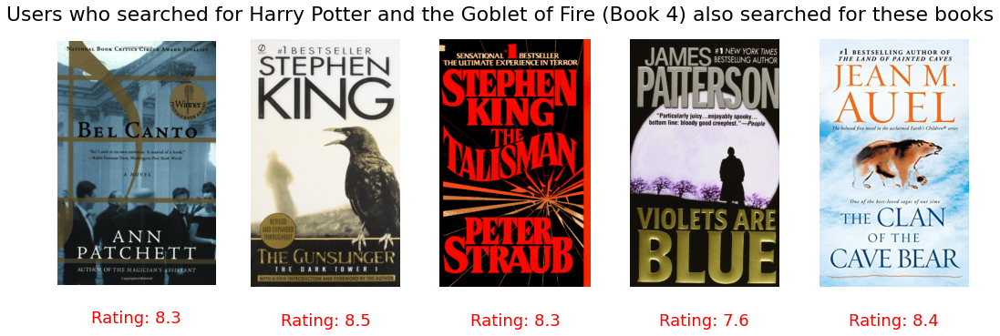

In [322]:
item_based_recommender('Harry Potter and the Goblet of Fire (Book 4)')

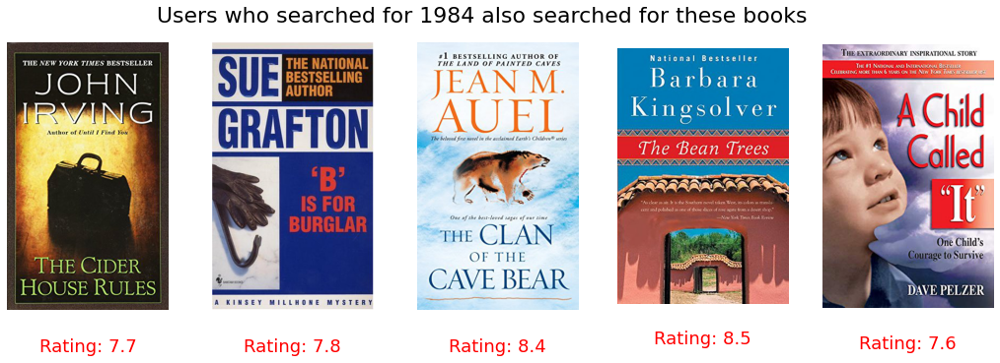

In [47]:
item_based_recommender('1984')

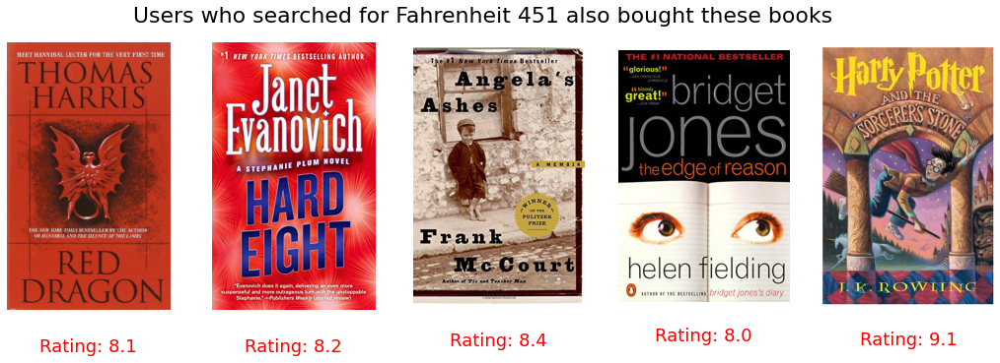

In [139]:
item_based_recommender('Fahrenheit 451')

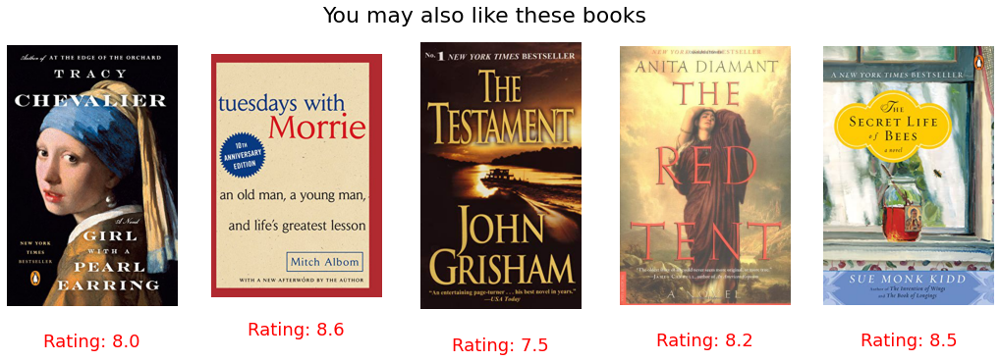

In [25]:
item_based_recommender('The Street Lawyer')

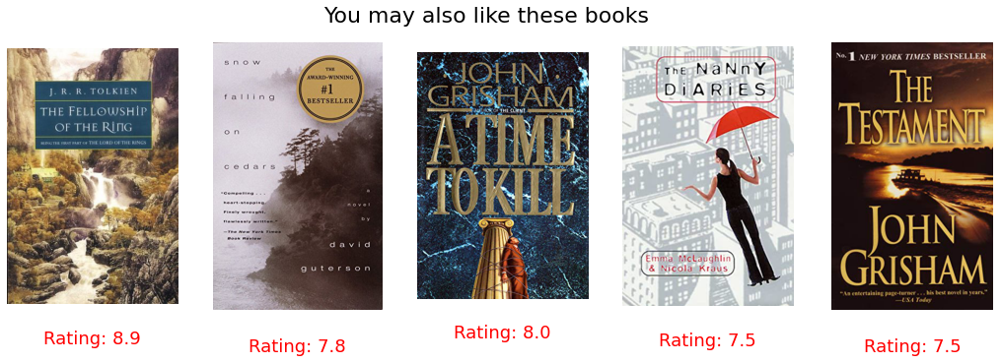

In [26]:
item_based_recommender('Divine Secrets of the Ya-Ya Sisterhood: A Novel')

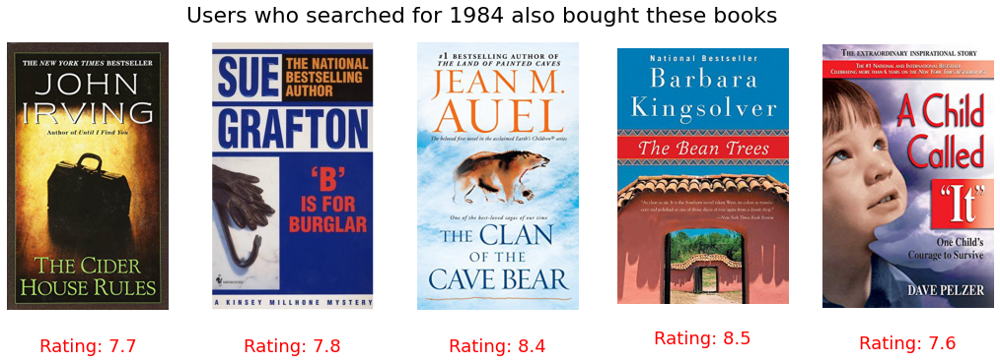

In [116]:
item_based_recommender('1984')

In [24]:
user_df = df.pivot_table(index=['user_id'], columns=['book_title'], values='rating').fillna(0)
user_df

book_title,1984,1st to Die: A Novel,2010: Odyssey Two,204 Rosewood Lane,24 Hours,2nd Chance,4 Blondes,84 Charing Cross Road,A 2nd Helping of Chicken Soup for the Soul (Chicken Soup for the Soul Series (Paper)),A Beautiful Mind: The Life of Mathematical Genius and Nobel Laureate John Nash,...,Women Who Run with the Wolves,"Word Freak: Heartbreak, Triumph, Genius, and Obsession in the World of Competitive Scrabble Players",Writ of Execution,Wuthering Heights,Wuthering Heights (Penguin Classics),Year of Wonders,You Belong To Me,Zen and the Art of Motorcycle Maintenance: An Inquiry into Values,Zoya,"\O\"" Is for Outlaw"""
user_id,,,,,,,,,,,,,,,,,,,,,
243,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
254,9.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
507,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
638,0.0,0.0,0.0,0.0,0.0,9.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
643,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
278188,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
278418,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
278582,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [25]:
cosine_similarity(user_df).shape

(2766, 2766)

In [26]:
cosine_sim = cosine_similarity(user_df)

In [27]:
user_sim_df = pd.DataFrame(cosine_sim)
# Set the index and column name to user Ids
user_sim_df.index = list(user_df.index)
user_sim_df.columns = list(user_df.index)
user_sim_df

,243,254,507,638,643,741,882,929,1025,1211,...,277639,277928,277965,278026,278137,278188,278418,278582,278633,278843
243,1.000000,0.000000,0.000000,0.112156,0.0,0.0,0.000000,0.0,0.0,0.00000,...,0.000000,0.000000,0.000000,0.060323,0.000000,0.0,0.000000,0.0,0.046657,0.000000
254,0.000000,1.000000,0.217949,0.000000,0.0,0.0,0.000000,0.0,0.0,0.00000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.091724
507,0.000000,0.217949,1.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.00000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000
638,0.112156,0.000000,0.000000,1.000000,0.0,0.0,0.126278,0.0,0.0,0.11995,...,0.059091,0.000000,0.050925,0.000000,0.071294,0.0,0.062037,0.0,0.092703,0.000000
643,0.000000,0.000000,0.000000,0.000000,1.0,0.0,0.000000,0.0,0.0,0.00000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
278188,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.00000,...,0.000000,0.000000,0.000000,0.000000,0.000000,1.0,0.000000,0.0,0.000000,0.000000
278418,0.000000,0.000000,0.000000,0.062037,0.0,0.0,0.000000,0.0,0.0,0.00000,...,0.000000,0.000000,0.000000,0.112987,0.000000,0.0,1.000000,0.0,0.000000,0.000000
278582,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.00000,...,0.000000,0.000000,0.000000,0.149551,0.000000,0.0,0.000000,1.0,0.000000,0.000000
278633,0.046657,0.000000,0.000000,0.092703,0.0,0.0,0.000000,0.0,0.0,0.00000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,1.000000,0.086913


In [28]:
index = np.where(user_sim_df.index == 243)[0][0]
index

0

In [29]:
user_sim_df.index[index]

243

In [30]:
user_sim_df[user_sim_df.index[index]]

243       1.000000
254       0.000000
507       0.000000
638       0.112156
643       0.000000
            ...   
278188    0.000000
278418    0.000000
278582    0.000000
278633    0.046657
278843    0.000000
Name: 243, Length: 2766, dtype: float64

In [33]:
sorted(list(enumerate(user_sim_df[user_sim_df.index[index]])),key=lambda x:x[1],reverse=True)[1:6]

[(2640, 0.3498557142706598),
 (2692, 0.24738534799764672),
 (775, 0.245872273571434),
 (321, 0.24489899998946185),
 (1380, 0.23990568889062117)]

In [46]:
sorted_sim_books = sorted(list(enumerate(user_sim_df[user_sim_df.index[index]])),key=lambda x:x[1],reverse=True)[1:11]

In [47]:
user_df.index[637]

65769

In [48]:
users = []
for i in sorted_sim_books:
    users.append(user_sim_df.index[i[0]])

In [49]:
users

[265403, 270629, 79556, 33474, 138777, 218411, 30810, 51082, 137437, 1435]

In [50]:
book_list = []
for i in users:
    book_list = book_list+list(df[df['user_id']==i]['book_title'])

In [67]:
book_list

['The Bean Trees',
 'The Bean Trees',
 'Prodigal Summer: A Novel',
 'Unnatural Exposure',
 'Memoirs of a Geisha Uk',
 'A Painted House',
 'The Red Tent (Bestselling Backlist)',
 'Seabiscuit: An American Legend',
 'The Bean Trees',
 'Me Talk Pretty One Day',
 'A Map of the World',
 "Harry Potter and the Sorcerer's Stone (Harry Potter (Paperback))",
 "Song of Solomon (Oprah's Book Club (Paperback))",
 'The Professor and the Madman: A Tale of Murder, Insanity, and the Making of The Oxford English Dictionary',
 'Prodigal Summer: A Novel',
 "The Samurai's Garden : A Novel",
 'Island of the Blue Dolphins',
 'Me Talk Pretty One Day',
 'White Teeth: A Novel',
 'Unnatural Exposure',
 'You Belong To Me',
 'My Gal Sunday',
 "Pretend You Don't See Her",
 'Unnatural Exposure',
 "Left Behind: A Novel of the Earth's Last Days (Left Behind No. 1)",
 'The Last Precinct',
 'All Creatures Great and Small',
 'Unnatural Exposure',
 'Jonathan Livingston Seagull',
 'Shopaholic Takes Manhattan (Summer Display

In [73]:
set(book_list)

{'A Case of Need',
 'A Map of the World',
 'A Painted House',
 'All Creatures Great and Small',
 "Angela's Ashes: A Memoir",
 'Chicken Soup for the Soul (Chicken Soup for the Soul)',
 'Congo',
 'Even Cowgirls Get the Blues',
 "Harry Potter and the Sorcerer's Stone (Harry Potter (Paperback))",
 'Hearts In Atlantis',
 'Island of the Blue Dolphins',
 'Jonathan Livingston Seagull',
 "Left Behind: A Novel of the Earth's Last Days (Left Behind No. 1)",
 'Me Talk Pretty One Day',
 'Memoirs of a Geisha Uk',
 'My Gal Sunday',
 "Pretend You Don't See Her",
 'Prodigal Summer: A Novel',
 'Seabiscuit: An American Legend',
 'Shopaholic Takes Manhattan (Summer Display Opportunity)',
 'Sleep No More',
 "Song of Solomon (Oprah's Book Club (Paperback))",
 'The Bean Trees',
 'The Cider House Rules',
 'The Empty Chair',
 "The Kitchen God's Wife",
 'The Last Precinct',
 'The Perfect Storm : A True Story of Men Against the Sea',
 'The Professor and the Madman: A Tale of Murder, Insanity, and the Making of T

In [74]:
len(set(book_list))

38

In [103]:
set(df[df['user_id']==243]['book_title'])

{'A Map of the World',
 'A Painted House',
 'Chicken Soup for the Soul (Chicken Soup for the Soul)',
 'Manhattan Hunt Club',
 'Me Talk Pretty One Day',
 'River, Cross My Heart',
 'The Bean Trees',
 "The General's Daughter",
 'The God of Small Things',
 'The Midnight Club',
 'The Patient',
 "The Pilot's Wife : A Novel",
 'Unnatural Exposure',
 'Vanished'}

In [106]:
df[df['user_id']==243]['book_title']

3275                                        The Bean Trees
3346                               The God of Small Things
3470                            The Pilot's Wife : A Novel
3859                                Me Talk Pretty One Day
3951                                 River, Cross My Heart
4323                                    A Map of the World
4402                                    Unnatural Exposure
4623                                       A Painted House
4785                                     The Midnight Club
4922                                   Manhattan Hunt Club
5176                                           The Patient
5291     Chicken Soup for the Soul (Chicken Soup for th...
10098                                             Vanished
34217                               The General's Daughter
Name: book_title, dtype: object

In [109]:
set(unique_list)-set(df[df['user_id']==243]['book_title'])

{'A Case of Need',
 'All Creatures Great and Small',
 "Angela's Ashes: A Memoir",
 'Congo',
 'Even Cowgirls Get the Blues',
 "Harry Potter and the Sorcerer's Stone (Harry Potter (Paperback))",
 'Hearts In Atlantis',
 'Island of the Blue Dolphins',
 'Jonathan Livingston Seagull',
 "Left Behind: A Novel of the Earth's Last Days (Left Behind No. 1)",
 'Memoirs of a Geisha Uk',
 'My Gal Sunday',
 "Pretend You Don't See Her",
 'Prodigal Summer: A Novel',
 'Seabiscuit: An American Legend',
 'Shopaholic Takes Manhattan (Summer Display Opportunity)',
 'Sleep No More',
 "Song of Solomon (Oprah's Book Club (Paperback))",
 'The Cider House Rules',
 'The Empty Chair',
 "The Kitchen God's Wife",
 'The Last Precinct',
 'The Perfect Storm : A True Story of Men Against the Sea',
 'The Professor and the Madman: A Tale of Murder, Insanity, and the Making of The Oxford English Dictionary',
 'The Red Tent (Bestselling Backlist)',
 "The Samurai's Garden : A Novel",
 'The Tommyknockers',
 'Tis : A Memoir',


In [113]:
final_books = sorted(set(book_list)-set(df[df['user_id']==243]['book_title']))

In [123]:
final_books[0:5]

['A Case of Need',
 'All Creatures Great and Small',
 "Angela's Ashes: A Memoir",
 'Congo',
 'Even Cowgirls Get the Blues']

In [135]:
final_books[5:10]

["Harry Potter and the Sorcerer's Stone (Harry Potter (Paperback))",
 'Hearts In Atlantis',
 'Island of the Blue Dolphins',
 'Jonathan Livingston Seagull',
 "Left Behind: A Novel of the Earth's Last Days (Left Behind No. 1)"]

###  **User Based Collaborative Filtering** - 

In [165]:
def user_based_recommender(user_id):
    
#     user_id = int(user_id)
    if user_id in df['user_id'].values:
            
        user_df = df.pivot_table(index=['user_id'], columns=['book_title'],
                                                    values='rating').fillna(0)
        
        cosine_sim = cosine_similarity(user_df)
        user_sim_df = pd.DataFrame(cosine_sim)
        # Set the index and column name to user Ids
        user_sim_df.index = list(user_df.index)
        user_sim_df.columns = list(user_df.index)
        index = np.where(user_sim_df.index == user_id)[0][0]
        sim_books = list(enumerate(user_sim_df[user_sim_df.index[index]]))
        sorted_sim_books = sorted(sim_books,key=lambda x:x[1],
                                      reverse=True)[1:50]
            
        users = []
        for i in sorted_sim_books:
            users.append(user_sim_df.index[i[0]])
            
        book_list = []
        for i in users:
            book_list = book_list+list(df[df['user_id']==i]['book_title'])
        
        final_books = sorted(set(book_list)-set(df[df['user_id']==user_id]['book_title']))
            
        fig, axs = plt.subplots(3, 5,figsize=(20,20))
        fig.suptitle('Recommendation for User ID: ' + str(user_id), size = 42, fontweight='bold')
        for i in range(len(final_books[0:5])):
        
            url = df.loc[df['book_title'] == final_books[i],'img_l'][:1].values[0]
            im = Image.open(requests.get(url, stream=True).raw)
            axs[0,i].imshow(im)
            axs[0,i].axis("off")
            axs[0,i].set_title('Rating: {}, \nAuthor: {}'\
                       .format(round(df[df['book_title'] == final_books[i]]['rating'].mean(),1),\
                               df['book_author'][df['book_title']== final_books[i]].values[0]),\
                        y=-0.15, color="black", fontsize=16, fontweight = 'bold', loc='left')
                
            fig.show()
        for i in range(len(final_books[0:5])):
        
            url = df.loc[df['book_title'] == final_books[i+5],'img_l'][:1].values[0]
            im = Image.open(requests.get(url, stream=True).raw)
            axs[1,i].imshow(im)
            axs[1,i].axis("off")
            axs[1,i].set_title('Rating: {}, \nAuthor: {}'\
                       .format(round(df[df['book_title'] == final_books[i+5]]['rating'].mean(),1),\
                               df['book_author'][df['book_title']== final_books[i+5]].values[0]),\
                        y=-0.15, color="black", fontsize=16, fontweight = 'bold', loc='left')
                
            fig.show()
        for i in range(len(final_books[0:5])):
        
            url = df.loc[df['book_title'] == final_books[i+10],'img_l'][:1].values[0]
            im = Image.open(requests.get(url, stream=True).raw)
            axs[2,i].imshow(im)
            axs[2,i].axis("off")
            axs[2,i].set_title('Rating: {}, \nAuthor: {}'\
                       .format(round(df[df['book_title'] == final_books[i+10]]['rating'].mean(),1),\
                               df['book_author'][df['book_title']== final_books[i+10]].values[0]),\
                        y=-0.15, color="black", fontsize=16, fontweight = 'bold', loc='left')
                
            fig.show()
        fig.tight_layout(pad = 2.0)
        plt.show()
    else:
        random = pd.Series(df['user_id'].unique()).sample(2).values
        print('Cant find user in dataset, please check spelling \n')
        print('Try: \n')
        print('{}'.format(random[0]),'\n')
        print('{}'.format(random[1]),'\n')
        print('{}'.format(random[2]),'\n')

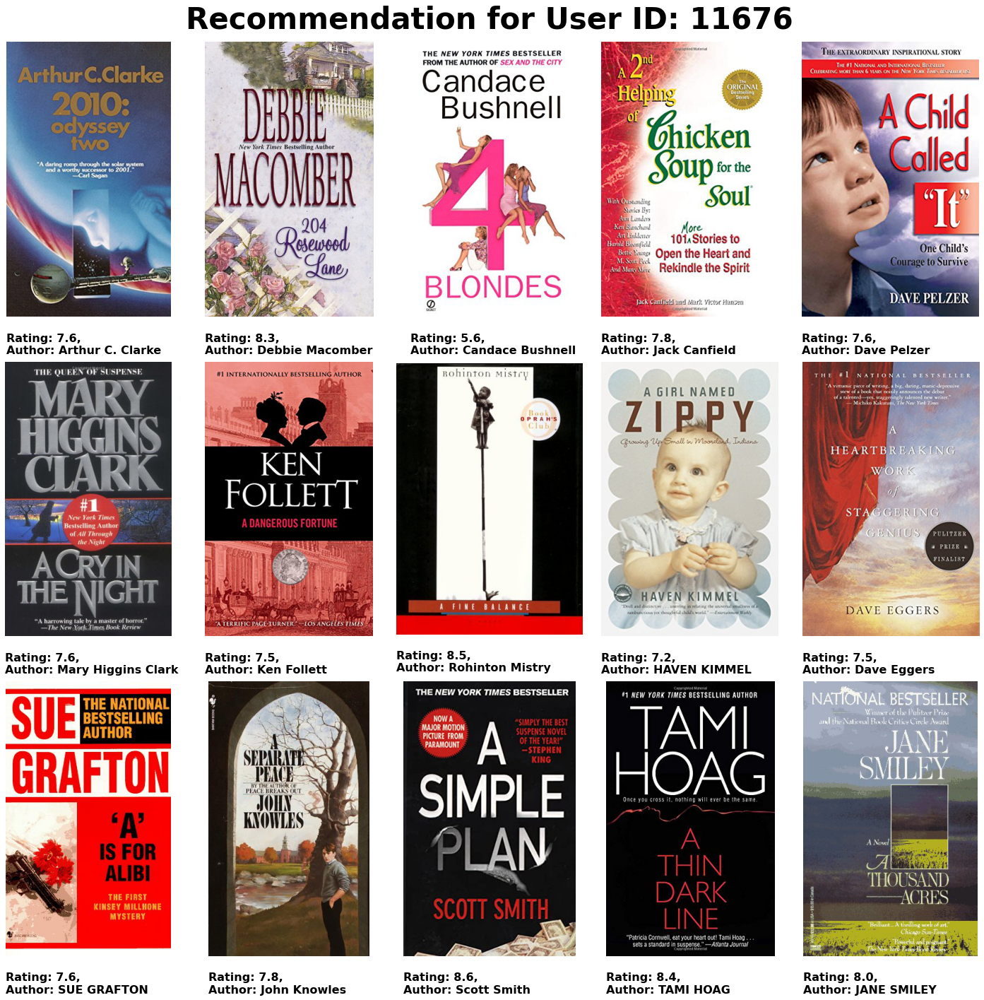

In [166]:
user_based_recommender(11676)

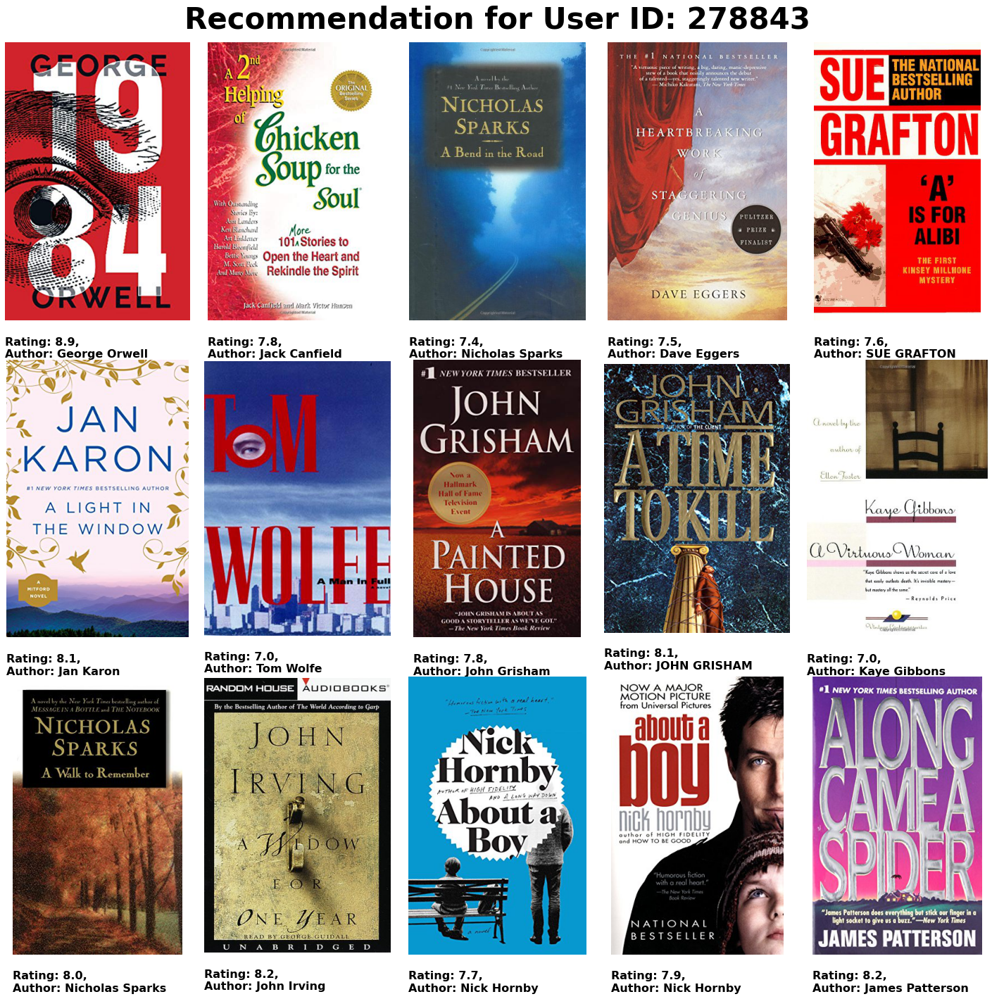

In [170]:
user_based_recommender(278843)

### Content-Based Collaborative Filterings<a class="anchor" id="6"></a>

In this recommender system the content of the book (itle, Author, Publisher, Category etc) is used to find its similarity with other books. Then the books that are most likely to be similar are recommended.

### Title, Author, Publisher, Category

In [309]:
def content_based_recommender(book_title):
    
    book_title = str(book_title)
    if book_title in df['book_title'].values:
        rating_counts = pd.DataFrame(df['book_title'].value_counts())
        rare_books = rating_counts[rating_counts['book_title'] <= 50].index
        common_books = df[~df['book_title'].isin(rare_books)]
        
        if book_title in rare_books:
            
            random = pd.Series(common_books['book_title'].unique()).sample(2).values
            print('There are no recommendations for this book')
            print('Try: \n')
            print('{}'.format(random[0]),'\n')
            print('{}'.format(random[1]),'\n')
        
        else:
            
            common_books = common_books.drop_duplicates(subset=['book_title'])
            common_books.reset_index(inplace= True)
            common_books['index'] = [i for i in range(common_books.shape[0])]
            target_cols = ['book_title','book_author','publisher','Category']
            common_books['combined_features'] = [' '.join(common_books[target_cols].iloc[i,].values) for i in range(common_books[target_cols].shape[0])]
            cv = CountVectorizer()
            count_matrix = cv.fit_transform(common_books['combined_features'])
            cosine_sim = cosine_similarity(count_matrix)
            index = common_books[common_books['book_title'] == book_title]['index'].values[0]
            sim_books = list(enumerate(cosine_sim[index]))
            sorted_sim_books = sorted(sim_books,key=lambda x:x[1],
                                      reverse=True)[1:6]
            
            fig = plt.figure(figsize=(18,5),dpi=100)
            url = df.loc[df['book_title'] == book_title,'img_l'][:1].values[0]
            im = Image.open(requests.get(url, stream=True).raw)
            plt.imshow(im)
            plt.axis('off')
            plt.title('Rating: {}, \nAuthor: {}'\
                       .format(round(df[df['book_title'] == book_title]['rating'].mean(),1),\
                               df['book_author'][df['book_title']== book_title].values[0]),\
                        y=-0.20, color="black", fontsize=14, fontweight='bold', loc='left')
            plt.show()
            
            books = []
            for i in range(len(sorted_sim_books)):
                books.append(common_books[common_books['index'] == sorted_sim_books[i][0]]['book_title'].item())
            
            fig, axs = plt.subplots(1, 5,figsize=(18,5))
            fig.suptitle('You may also like these books', size = 22)
            for i in range(len(books)):
        
                url = common_books.loc[common_books['book_title'] == books[i],'img_l'][:1].values[0]
                im = Image.open(requests.get(url, stream=True).raw)
                axs[i].imshow(im)
                axs[i].axis("off")
                axs[i].set_title('Rating: {}, \nAuthor: {}'\
                       .format(round(df[df['book_title'] == books[i]]['rating'].mean(),1),\
                               df['book_author'][df['book_title']== books[i]].values[0]),\
                        y=-0.20, color="black", fontsize=14, fontweight='bold', loc='left')
                fig.show()
                     
    else:
        
        print('Cant find book in dataset, please check spelling')

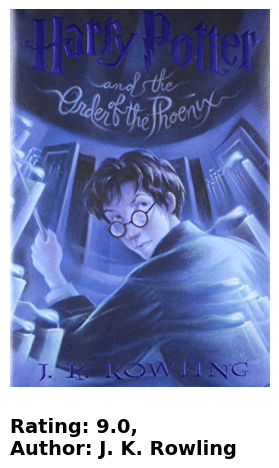

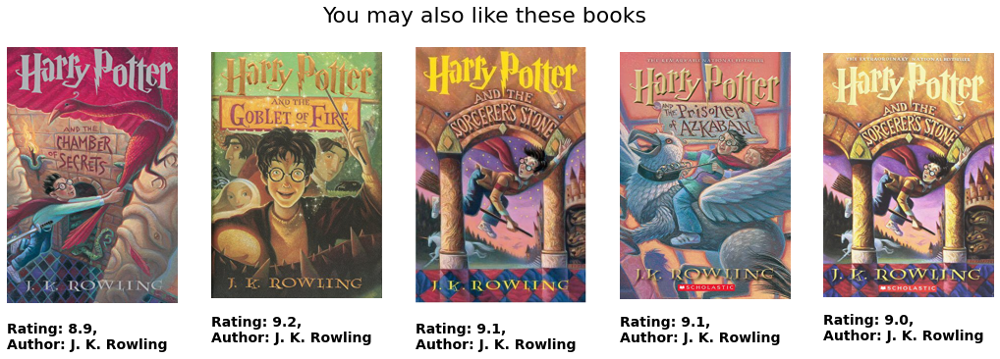

In [310]:
content_based_recommender('Harry Potter and the Order of the Phoenix (Book 5)')

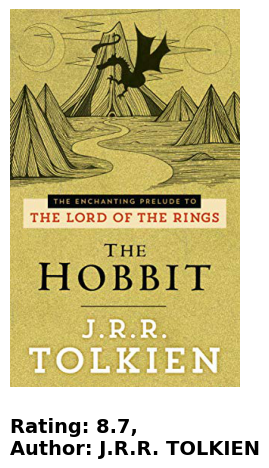

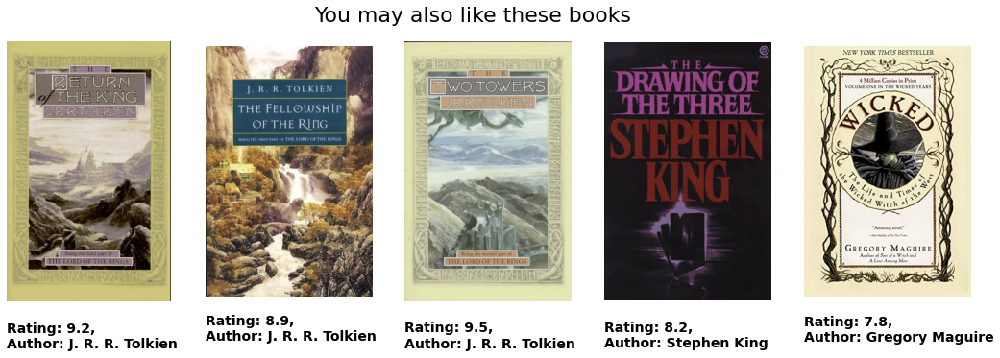

In [311]:
content_based_recommender('The Hobbit : The Enchanting Prelude to The Lord of the Rings')

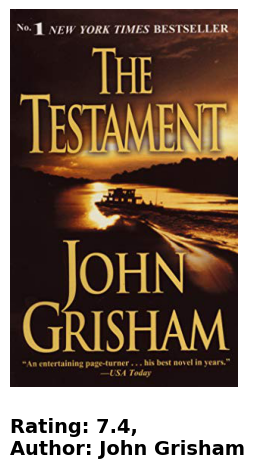

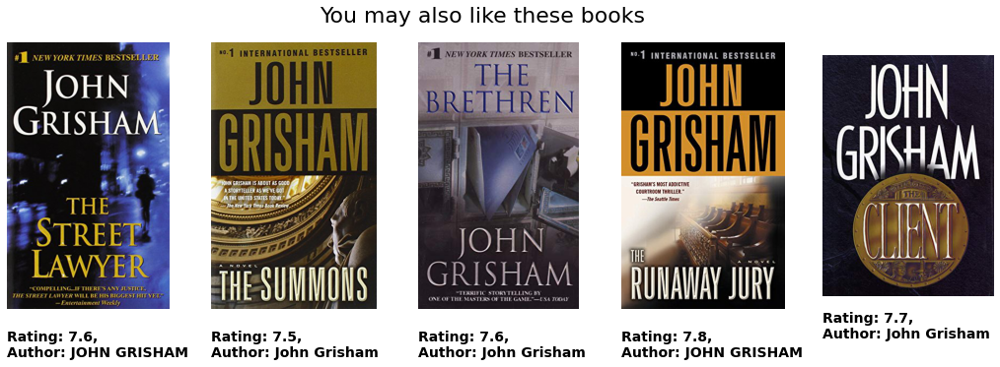

In [312]:
content_based_recommender('The Testament')

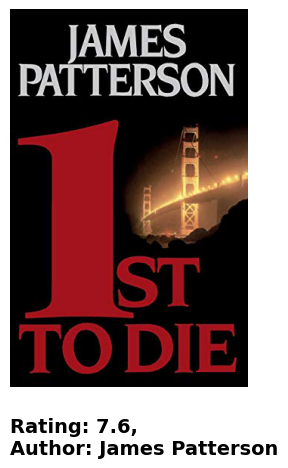

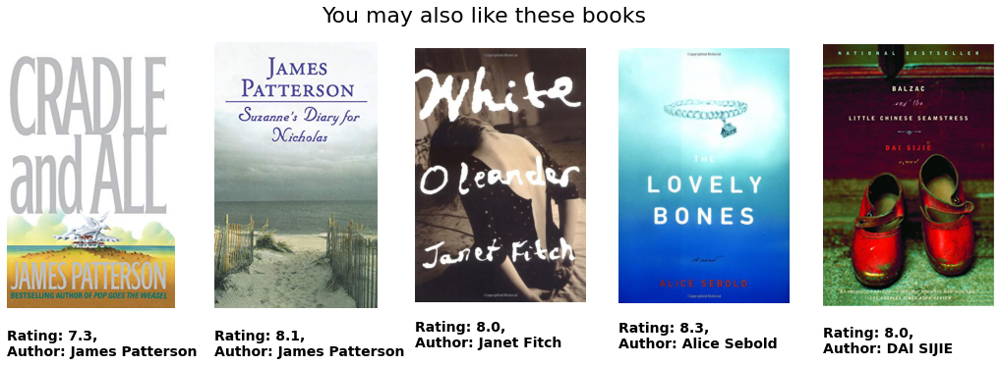

In [313]:
content_based_recommender('1st to Die: A Novel')

### Title, Author and Publisher

In [148]:
def content_based_recommender(book_title):
    
    book_title = str(book_title)
    if book_title in df['book_title'].values:
        rating_counts = pd.DataFrame(df['book_title'].value_counts())
        rare_books = rating_counts[rating_counts['book_title'] <= 50].index
        common_books = df[~df['book_title'].isin(rare_books)]
        
        if book_title in rare_books:
            
            random = pd.Series(common_books['book_title'].unique()).sample(2).values
            print('There are no recommendations for this book')
            print('Try: \n')
            print('{}'.format(random[0]),'\n')
            print('{}'.format(random[1]),'\n')
        
        else:
            
            common_books = common_books.drop_duplicates(subset=['book_title'])
            common_books.reset_index(inplace= True)
            common_books['index'] = [i for i in range(common_books.shape[0])]
            target_cols = ['book_title','book_author','publisher']
            common_books['combined_features'] = [' '.join(common_books[target_cols].iloc[i,].values) for i in range(common_books[target_cols].shape[0])]
            cv = CountVectorizer()
            count_matrix = cv.fit_transform(common_books['combined_features'])
            cosine_sim = cosine_similarity(count_matrix)
            index = common_books[common_books['book_title'] == book_title]['index'].values[0]
            sim_books = list(enumerate(cosine_sim[index]))
            sorted_sim_books = sorted(sim_books,key=lambda x:x[1],
                                      reverse=True)[1:6]
            
            books = []
            for i in range(len(sorted_sim_books)):
                books.append(common_books[common_books['index'] == sorted_sim_books[i][0]]['book_title'].item())
            
            fig, axs = plt.subplots(1, 5,figsize=(18,5))
            fig.suptitle('You may also like these books', size = 22)
            for i in range(len(books)):
        
                url = common_books.loc[common_books['book_title'] == books[i],'img_l'][:1].values[0]
                im = Image.open(requests.get(url, stream=True).raw)
                axs[i].imshow(im)
                axs[i].axis("off")
                axs[i].set_title('Rating: {}'.format(round(df[df['book_title'] == books[i]]['rating'].mean(),1)),
                             y=-0.18,
                                 color="red",
                                 fontsize=18)
                fig.show()
                     
    else:
        
        print('Cant find book in dataset, please check spelling')

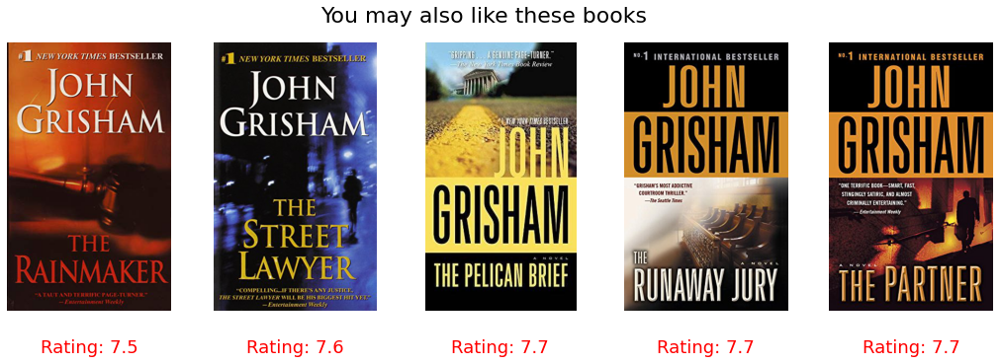

In [98]:
content_based_recommender('The Testament')

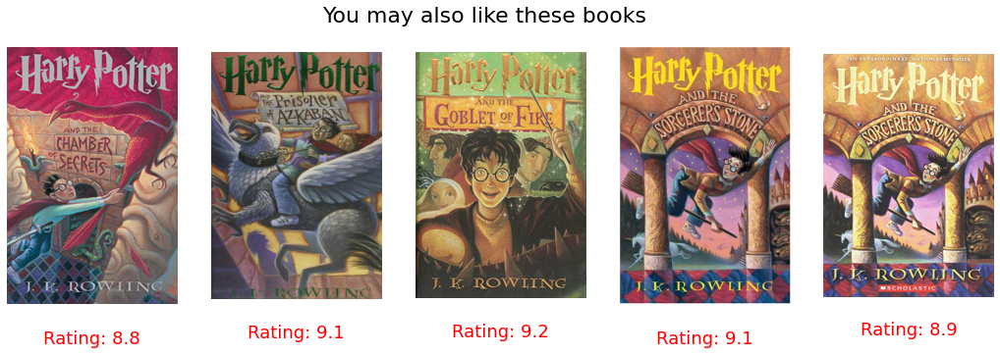

In [103]:
content_based_recommender('Harry Potter and the Order of the Phoenix (Book 5)')

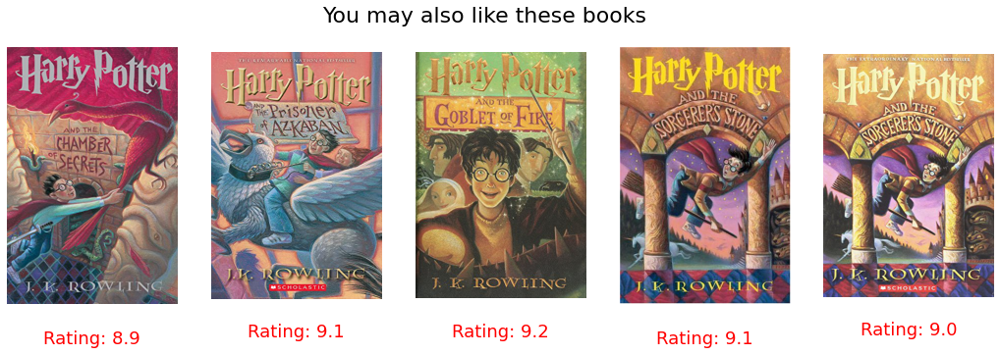

In [149]:
content_based_recommender('Harry Potter and the Order of the Phoenix (Book 5)')

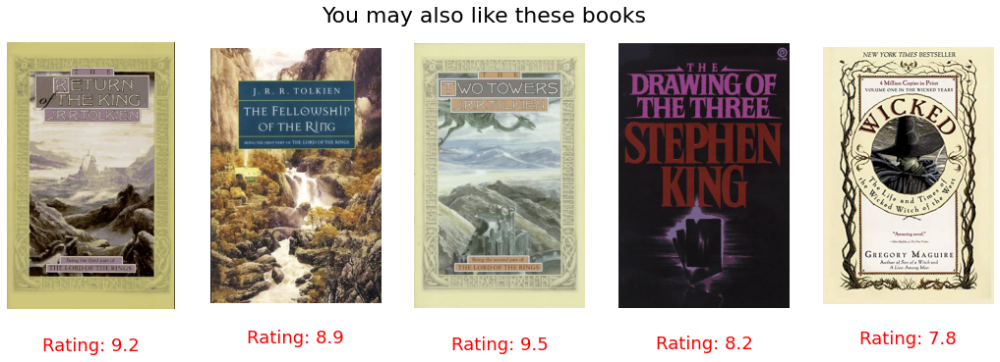

In [150]:
content_based_recommender('The Hobbit : The Enchanting Prelude to The Lord of the Rings')

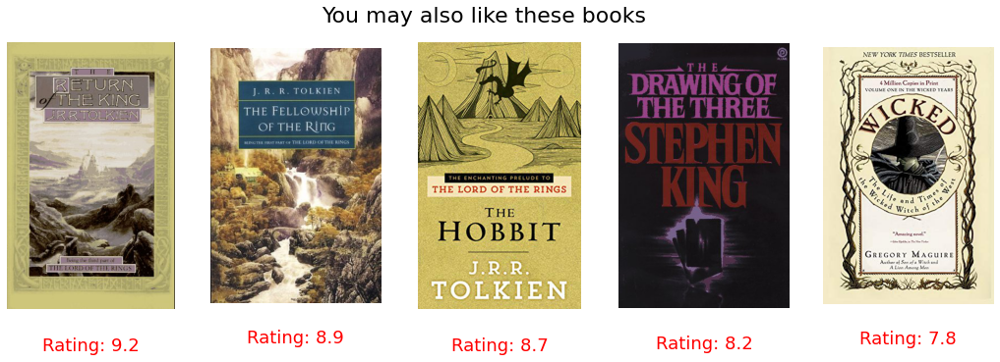

In [151]:
content_based_recommender('The Two Towers (The Lord of the Rings, Part 2)')

## **Summary based Recommender**<a class="anchor" id="7"></a>

We will compute pairwise similarity scores for all books based on their plot summary and recommend books based on that similarity score. The summary description is given in the **Summary** feature of our dataset. 
Let's take a look at the data. .. 

In [152]:
def summary_based_recommender(book_title):
    
    book_title = str(book_title)
    if book_title in df['book_title'].values:
        rating_counts = pd.DataFrame(df['book_title'].value_counts())
        rare_books = rating_counts[rating_counts['book_title'] <= 50].index
        common_books = df[~df['book_title'].isin(rare_books)]
        
        if book_title in rare_books:
            
            random = pd.Series(common_books['book_title'].unique()).sample(2).values
            print('There are no recommendations for this book')
            print('Try: \n')
            print('{}'.format(random[0]),'\n')
            print('{}'.format(random[1]),'\n')
        
        else:
            common_books = common_books.drop_duplicates(subset=['book_title'])
            common_books.reset_index(inplace= True)
            common_books['index'] = [i for i in range(common_books.shape[0])]
            
            summary_filtered = []
            for i in common_books['Summary']:
                
                i = re.sub("[^a-zA-Z]"," ",i).lower()
                i = nltk.word_tokenize(i)
                i = [word for word in i if not word in set(stopwords.words("english"))]
                i = " ".join(i)
                summary_filtered.append(i)
            
            common_books['Summary'] = summary_filtered   
            cv = CountVectorizer()
            count_matrix = cv.fit_transform(common_books['Summary'])
            cosine_sim = cosine_similarity(count_matrix)
            index = common_books[common_books['book_title'] == book_title]['index'].values[0]
            sim_books = list(enumerate(cosine_sim[index]))
            sorted_sim_books = sorted(sim_books,key=lambda x:x[1],reverse=True)[1:6]
            
            books = []
            for i in range(len(sorted_sim_books)):
                books.append(common_books[common_books['index'] == sorted_sim_books[i][0]]['book_title'].item())
            
            fig, axs = plt.subplots(1, 5,figsize=(18,5))
            fig.suptitle('You may also like these books', size = 22)
            for i in range(len(books)):
        
                url = common_books.loc[common_books['book_title'] == books[i],'img_l'][:1].values[0]
                im = Image.open(requests.get(url, stream=True).raw)
                axs[i].imshow(im)
                axs[i].axis("off")
                axs[i].set_title('Rating: {}'.format(round(df[df['book_title'] == books[i]]['rating'].mean(),1)),
                             y=-0.18,
                                 color="red",
                                 fontsize=18)
                fig.show()
                     
    else:
        
        print('Cant find book in dataset, please check spelling')

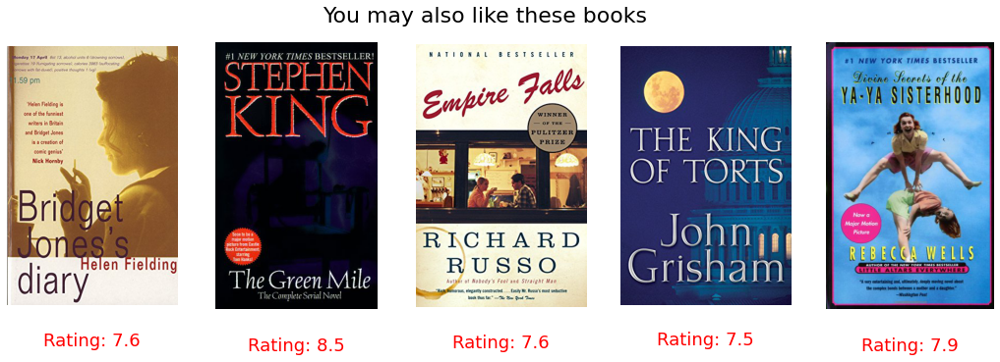

In [39]:
summary_based_recommender('To Kill a Mockingbird')

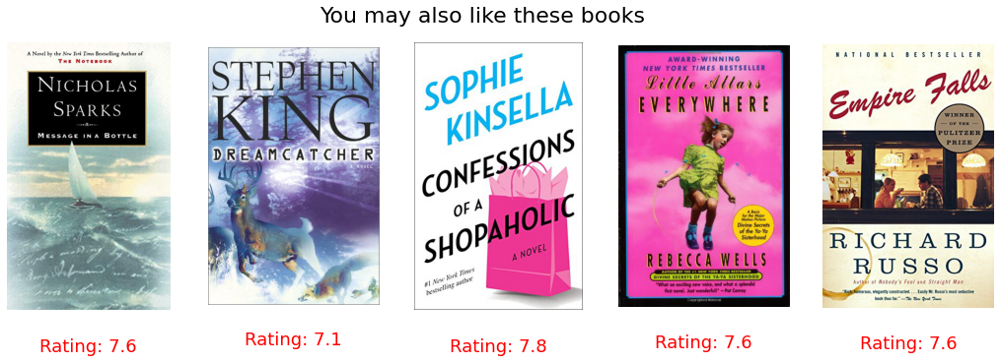

In [40]:
summary_based_recommender('A Walk to Remember')

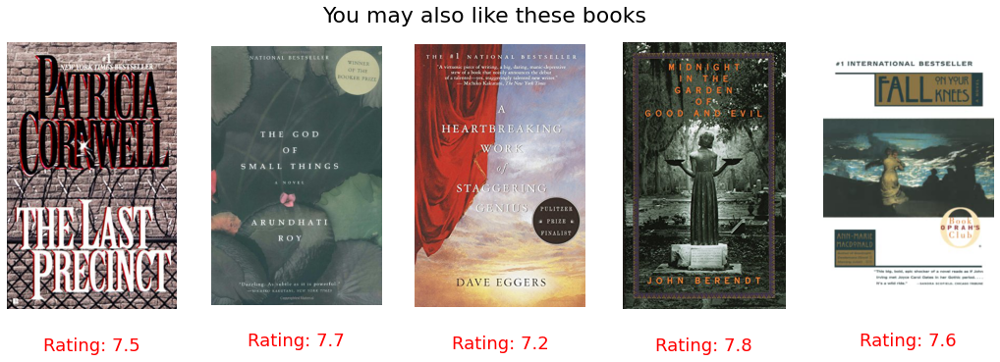

In [41]:
summary_based_recommender('A Painted House')

### Comparison of All Recommenders<a class="anchor" id="8"></a>

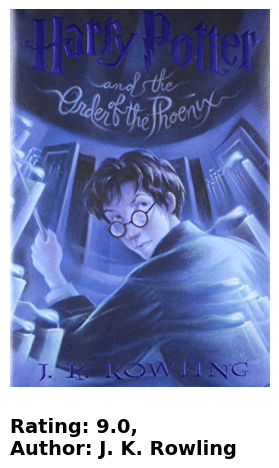

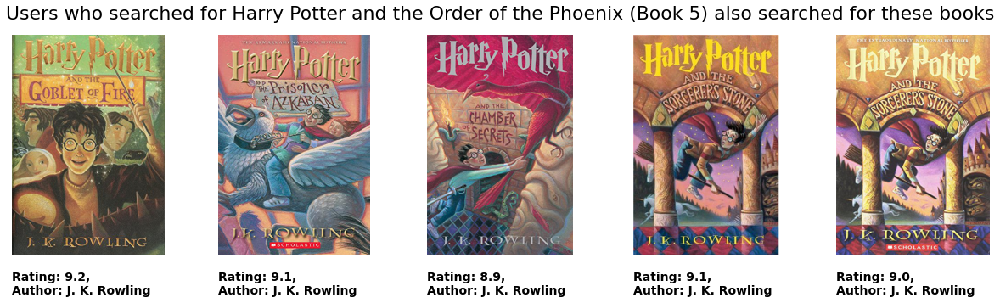

In [314]:
item_based_recommender('Harry Potter and the Order of the Phoenix (Book 5)')

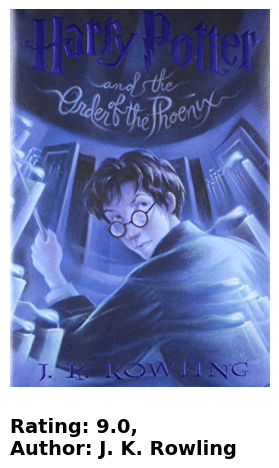

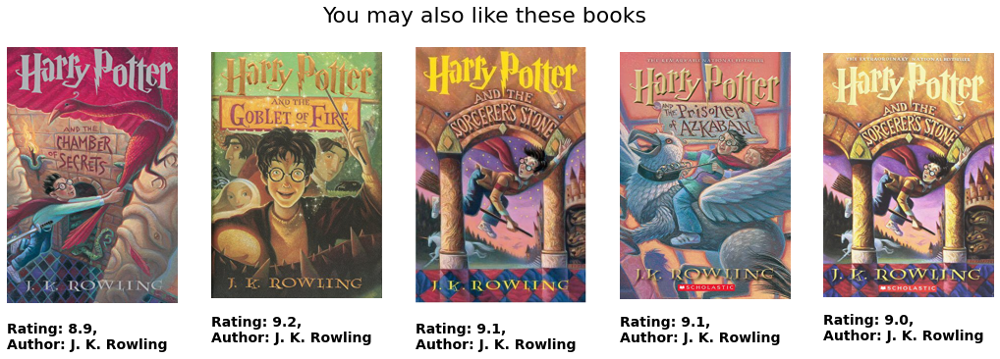

In [315]:
content_based_recommender('Harry Potter and the Order of the Phoenix (Book 5)')

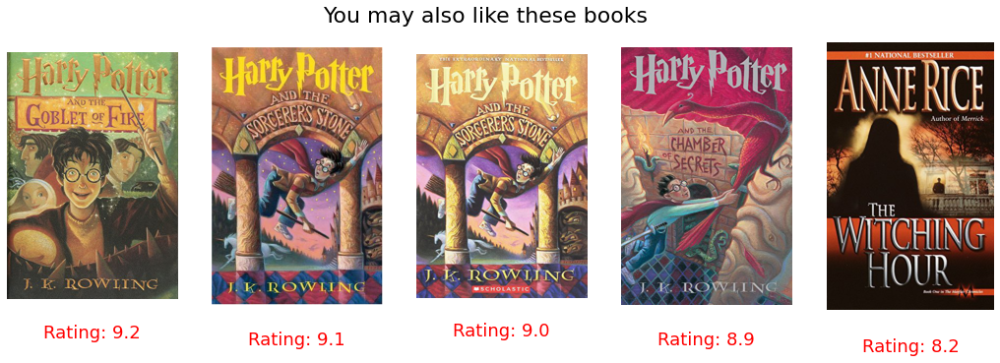

In [155]:
summary_based_recommender('Harry Potter and the Order of the Phoenix (Book 5)')

## **Conclusion** <a class="anchor" id="9"></a>
We create recommenders using demographic , content- based and collaborative filtering. While demographic filtering is very elemantary and cannot be used practically, **Hybrid Systems** can take advantage of content-based and collaborative filtering as the two approaches are proved to be almost complimentary.
This model was very baseline and only provides a fundamental framework to start with.

I would like to mention some excellent refereces that I learned from
1. [https://hackernoon.com/introduction-to-recommender-system-part-1-collaborative-filtering-singular-value-decomposition-44c9659c5e75](https://hackernoon.com/introduction-to-recommender-system-part-1-collaborative-filtering-singular-value-decomposition-44c9659c5e75)
2. [https://www.kaggle.com/rounakbanik/movie-recommender-systems](https://www.kaggle.com/rounakbanik/movie-recommender-systems)
